# Исследование данных о российском кинопрокате

Заказчик этого исследования — Министерство культуры Российской Федерации.

Изучим рынок российского кинопроката и выявим текущие тренды. Уделим внимание фильмам, которые получили государственную поддержку. Попробуем ответить на вопрос, насколько такие фильмы интересны зрителю.

Будем работать с данными, опубликованными на [портале открытых данных Министерства культуры](http://opendata.mkrf.ru/). Набор данных содержит информацию о прокатных удостоверениях, сборах и государственной поддержке фильмов, а также информацию с сайта КиноПоиск.

**Что в анализе?**

- Исследуем ежегодный прокат, посмотрим на долю представленных в датафрейме картин с наличием информации о кассовых сборах
- Посмотрим на динамику проката по годам, на численные показатели сборов (среднее, медиану)
- Узнаем, влияет ли возрастное ограничение на сумму сборов, и если да, то насколько сильно; какое ограничение имеет наибольший "профит" — обратное от потерь
- Проанализируем фильмы с государственной поддержкой: посмотрим, сколько средств выделяют на поддержку кино, насколько хорошо окупаюся фильмы с поддержкой, какой у них рейтинг, ежегодные тренды и тенденции

<h1>Этапы<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Начало" data-toc-modified-id="Начало-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Начало</a></span><ul class="toc-item"><li><span><a href="#Вывод-по-первому-этапу" data-toc-modified-id="Вывод-по-первому-этапу-1.1"><span class="toc-item-num">1.1&nbsp;&nbsp;</span>Вывод по первому этапу</a></span></li></ul></li><li><span><a href="#Предобработка-данных" data-toc-modified-id="Предобработка-данных-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>Предобработка данных</a></span><ul class="toc-item"><li><span><a href="#Проверим-типы-данных" data-toc-modified-id="Проверим-типы-данных-2.1"><span class="toc-item-num">2.1&nbsp;&nbsp;</span>Проверим типы данных</a></span></li><li><span><a href="#Изучим-пропуски-в-датафрейме" data-toc-modified-id="Изучим-пропуски-в-датафрейме-2.2"><span class="toc-item-num">2.2&nbsp;&nbsp;</span>Изучим пропуски в датафрейме</a></span></li><li><span><a href="#Изучим-дубликаты-в-датафрейме" data-toc-modified-id="Изучим-дубликаты-в-датафрейме-2.3"><span class="toc-item-num">2.3&nbsp;&nbsp;</span>Изучим дубликаты в датафрейме</a></span></li><li><span><a href="#Изучим-категориальные-значения" data-toc-modified-id="Изучим-категориальные-значения-2.4"><span class="toc-item-num">2.4&nbsp;&nbsp;</span>Изучим категориальные значения</a></span></li><li><span><a href="#Проверим-количественные-значения" data-toc-modified-id="Проверим-количественные-значения-2.5"><span class="toc-item-num">2.5&nbsp;&nbsp;</span>Проверим количественные значения</a></span></li><li><span><a href="#Новые-столбцы" data-toc-modified-id="Новые-столбцы-2.6"><span class="toc-item-num">2.6&nbsp;&nbsp;</span>Новые столбцы</a></span></li><li><span><a href="#Вывод-по-второму-этапу" data-toc-modified-id="Вывод-по-второму-этапу-2.7"><span class="toc-item-num">2.7&nbsp;&nbsp;</span>Вывод по второму этапу</a></span></li></ul></li><li><span><a href="#Исследовательский-анализ-данных" data-toc-modified-id="Исследовательский-анализ-данных-3"><span class="toc-item-num">3&nbsp;&nbsp;</span>Исследовательский анализ данных</a></span><ul class="toc-item"><li><span><a href="#Ежегодный-прокат.-Доли-и-лучшее-время" data-toc-modified-id="Ежегодный-прокат.-Доли-и-лучшее-время-3.1"><span class="toc-item-num">3.1&nbsp;&nbsp;</span>Ежегодный прокат. Доли и лучшее время</a></span></li><li><span><a href="#Динамика-проката,-среднее-и-медиана-сборов" data-toc-modified-id="Динамика-проката,-среднее-и-медиана-сборов-3.2"><span class="toc-item-num">3.2&nbsp;&nbsp;</span>Динамика проката, среднее и медиана сборов</a></span></li><li><span><a href="#Возрастное-ограничение-и-сборы" data-toc-modified-id="Возрастное-ограничение-и-сборы-3.3"><span class="toc-item-num">3.3&nbsp;&nbsp;</span>Возрастное ограничение и сборы</a></span></li><li><span><a href="#Вывод-по-третьему-этапу" data-toc-modified-id="Вывод-по-третьему-этапу-3.4"><span class="toc-item-num">3.4&nbsp;&nbsp;</span>Вывод по третьему этапу</a></span></li></ul></li><li><span><a href="#Фильмы-с-государственной-поддержкой" data-toc-modified-id="Фильмы-с-государственной-поддержкой-4"><span class="toc-item-num">4&nbsp;&nbsp;</span>Фильмы с государственной поддержкой</a></span><ul class="toc-item"><li><span><a href="#Суммы-выделяемой-финансовой-помощи" data-toc-modified-id="Суммы-выделяемой-финансовой-помощи-4.1"><span class="toc-item-num">4.1&nbsp;&nbsp;</span>Суммы выделяемой финансовой помощи</a></span></li><li><span><a href="#Кассовые-сборы" data-toc-modified-id="Кассовые-сборы-4.2"><span class="toc-item-num">4.2&nbsp;&nbsp;</span>Кассовые сборы</a></span></li><li><span><a href="#Окупаемость" data-toc-modified-id="Окупаемость-4.3"><span class="toc-item-num">4.3&nbsp;&nbsp;</span>Окупаемость</a></span></li><li><span><a href="#Средняя-окупаемость-и-тенденции" data-toc-modified-id="Средняя-окупаемость-и-тенденции-4.4"><span class="toc-item-num">4.4&nbsp;&nbsp;</span>Средняя окупаемость и тенденции</a></span></li><li><span><a href="#Аудиторная-поддержка-и-источники-финансирования" data-toc-modified-id="Аудиторная-поддержка-и-источники-финансирования-4.5"><span class="toc-item-num">4.5&nbsp;&nbsp;</span>Аудиторная поддержка и источники финансирования</a></span></li><li><span><a href="#Вывод-по-четвертому-этапу" data-toc-modified-id="Вывод-по-четвертому-этапу-4.6"><span class="toc-item-num">4.6&nbsp;&nbsp;</span>Вывод по четвертому этапу</a></span></li></ul></li><li><span><a href="#Общий-вывод" data-toc-modified-id="Общий-вывод-5"><span class="toc-item-num">5&nbsp;&nbsp;</span>Общий вывод</a></span><ul class="toc-item"><li><span><a href="#Описание-данных" data-toc-modified-id="Описание-данных-5.1"><span class="toc-item-num">5.1&nbsp;&nbsp;</span>Описание данных</a></span></li><li><span><a href="#Описание-работы" data-toc-modified-id="Описание-работы-5.2"><span class="toc-item-num">5.2&nbsp;&nbsp;</span>Описание работы</a></span></li><li><span><a href="#Результаты-работы" data-toc-modified-id="Результаты-работы-5.3"><span class="toc-item-num">5.3&nbsp;&nbsp;</span>Результаты работы</a></span></li></ul></li></ul></div>

<a id="item-one"></a>
## Начало 

Объединим данные таким образом, чтобы все объекты из датасета `mkrf_movies` обязательно вошли в получившийся датафрейм. 


In [1]:
# импортируем библиотеки
import pandas as pd
import matplotlib.pyplot as plt
import re
import numpy as np
import seaborn as sns

In [2]:
# создаем первую переменную для синергии и выводим о ней инфу
movies = pd.read_csv('/datasets/mkrf_movies.csv')
movies.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7486 entries, 0 to 7485
Data columns (total 15 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   title                  7486 non-null   object 
 1   puNumber               7486 non-null   object 
 2   show_start_date        7486 non-null   object 
 3   type                   7486 non-null   object 
 4   film_studio            7468 non-null   object 
 5   production_country     7484 non-null   object 
 6   director               7477 non-null   object 
 7   producer               6918 non-null   object 
 8   age_restriction        7486 non-null   object 
 9   refundable_support     332 non-null    float64
 10  nonrefundable_support  332 non-null    float64
 11  budget                 332 non-null    float64
 12  financing_source       332 non-null    object 
 13  ratings                6519 non-null   object 
 14  genres                 6510 non-null   object 
dtypes: f

In [3]:
# знакомимся
movies.head(10)

,title,puNumber,show_start_date,type,film_studio,production_country,director,producer,age_restriction,refundable_support,nonrefundable_support,budget,financing_source,ratings,genres
0,Открытый простор,221048915,2015-11-27T12:00:00.000Z,Художественный,"Тачстоун Пикчерз, Кобальт Пикчерз, Бикон Пикче...",США,Кевин Костнер,"Дэвид Валдес, Кевин Костнер, Джейк Эбертс",«18+» - запрещено для детей,NaN,NaN,NaN,NaN,7.2,"боевик,драма,мелодрама"
1,Особо важное задание,111013716,2016-09-13T12:00:00.000Z,Художественный,"Киностудия ""Мосфильм""",СССР,Е.Матвеев,NaN,«6+» - для детей старше 6 лет,NaN,NaN,NaN,NaN,6.6,"драма,военный"
2,Особо опасен,221038416,2016-10-10T12:00:00.000Z,Художественный,"Юниверсал Пикчерз, Кикстарт Продакшнз, Марк Пл...",США,Тимур Бекмамбетов,"Джим Лемли, Джейсон Нетер, Марк Е.Платт, Яйн Смит",«18+» - запрещено для детей,NaN,NaN,NaN,NaN,6.8,"фантастика,боевик,триллер"
3,Особо опасен,221026916,2016-06-10T12:00:00.000Z,Художественный,"Юниверсал Пикчерз, Кикстарт Продакшнз, Марк Пл...",США,Тимур Бекмамбетов,"Джим Лемли, Джейсон Нетер, Марк Е.Платт, Яйн Смит",«18+» - запрещено для детей,NaN,NaN,NaN,NaN,6.8,"фантастика,боевик,триллер"
4,Особо опасен,221030815,2015-07-29T12:00:00.000Z,Художественный,"Юниверсал Пикчерз, Кикстарт Продакшнз, Марк Пл...",США,Тимур Бекмамбетов,"Джим Лемли, Джейсон Нетер, Марк Е.Платт, Яйн Смит",«18+» - запрещено для детей,NaN,NaN,NaN,NaN,6.8,"фантастика,боевик,триллер"
5,Остановился поезд,111013816,2016-09-13T12:00:00.000Z,Художественный,"Киностудия ""Мосфильм""",СССР,В.Абдрашитов,NaN,«6+» - для детей старше 6 лет,NaN,NaN,NaN,NaN,7.7,драма
6,Любовь и голуби,111007013,2013-10-18T12:00:00.000Z,Художественный,"Киностудия ""Мосфильм""",СССР,В.Меньшов,NaN,«12+» - для детей старше 12 лет,NaN,NaN,NaN,NaN,8.3,"мелодрама,комедия"
7,Любовь и сигареты,221074614,2014-12-29T12:00:00.000Z,Художественный,"Юнайтед Артистс, Грин Стрит Филмз, Айкон Интер...",США,Джон Туртурро,"Джон Пенотти, Джон Туртурро",«18+» - запрещено для детей,NaN,NaN,NaN,NaN,6.6,"мюзикл,мелодрама,комедия"
8,Отпетые мошенники.,121011416,2016-05-05T12:00:00.000Z,Художественный,"Пульсар Продюксьон, ТФ1 Фильм",Франция,Эрик Беснард,Патрис Леду,«18+» - запрещено для детей,NaN,NaN,NaN,NaN,8.0,"комедия,криминал"
9,Отпуск за свой счет,111019114,2014-12-01T12:00:00.000Z,Художественный,"Киностудия ""Мосфильм"", Телевидение ВНР","СССР, Венгрия",В.Титов,NaN,«12+» - для детей старше 12 лет,NaN,NaN,NaN,NaN,7.8,"мелодрама,комедия"


In [4]:
# проделываем то же самое со вторым датасетом
shows = pd.read_csv('/datasets/mkrf_shows.csv')
shows.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3158 entries, 0 to 3157
Data columns (total 2 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   puNumber    3158 non-null   int64  
 1   box_office  3158 non-null   float64
dtypes: float64(1), int64(1)
memory usage: 49.5 KB


In [5]:
# второе знакомство
shows.head()

,puNumber,box_office
0,111000113,2.450000e+03
1,111000115,6.104000e+04
2,111000116,1.530300e+08
3,111000117,1.226096e+07
4,111000118,1.636841e+08


Неудобство spotted! Неприятный экспоненциальный формат. Исправим его.

In [6]:
pd.options.display.float_format = '{:,.2f}'.format

Проверим, получилось ли.

In [7]:
shows.head()

,puNumber,box_office
0,111000113,"2,450.00"
1,111000115,"61,040.00"
2,111000116,"153,030,013.40"
3,111000117,"12,260,956.00"
4,111000118,"163,684,057.79"


Отлично. Теперь все видно. Будем объединять массивы по `'puNumber'`. Единственное, типы этих столбцов отличаются. Исправим это недоразумение. Сначала, найдем пропущенные значения и устраним их, поскольку int64 их не поддерживает.

In [8]:
# переводим столбец
movies['puNumber'] = pd.to_numeric(movies['puNumber'], errors='coerce')
# находим количество пропущенных значений
movies['puNumber'].isna().sum()

1

In [9]:
# удаляем пропущенные значения
movies.dropna(subset=['puNumber'], inplace=True)
try:
    movies['puNumber'] = movies['puNumber'].astype(int)
    print('Пропущенные значения отсутствуют, тип столбца изменен.')
except ValueError as e:
    print(f'Ошибка: {e}')

Пропущенные значения отсутствуют, тип столбца изменен.


Ок! Отлично, двигаемся дальше.

In [10]:
# объединяем массивы с акцентом на "левом" (vid)
vid = movies.merge(shows, on='puNumber', how='left')
# смотрим инфу о получившемся датафрейме
vid.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 7485 entries, 0 to 7484
Data columns (total 16 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   title                  7485 non-null   object 
 1   puNumber               7485 non-null   int64  
 2   show_start_date        7485 non-null   object 
 3   type                   7485 non-null   object 
 4   film_studio            7467 non-null   object 
 5   production_country     7483 non-null   object 
 6   director               7476 non-null   object 
 7   producer               6917 non-null   object 
 8   age_restriction        7485 non-null   object 
 9   refundable_support     332 non-null    float64
 10  nonrefundable_support  332 non-null    float64
 11  budget                 332 non-null    float64
 12  financing_source       332 non-null    object 
 13  ratings                6519 non-null   object 
 14  genres                 6510 non-null   object 
 15  box_

Ок. У нас получилось объединить массивы, а номер прокатного удостоверения — целочисленный. При объединении, мы использовали в функции `.merge()` параметр `how='left'`. Это означает, что все значения из левого датасета (коим является `mkrf_movies`, занесенный в переменную `movies`) обязательно должны были войти в новый датафрейм.

In [11]:
# снимаем ограничения на вывод
pd.set_option('display.max_rows', None,
              'display.max_columns', None)
vid.query('box_office >= 0').head(5)

,title,puNumber,show_start_date,type,film_studio,production_country,director,producer,age_restriction,refundable_support,nonrefundable_support,budget,financing_source,ratings,genres,box_office
6,Любовь и голуби,111007013,2013-10-18T12:00:00.000Z,Художественный,"Киностудия ""Мосфильм""",СССР,В.Меньшов,NaN,«12+» - для детей старше 12 лет,NaN,NaN,NaN,NaN,8.3,"мелодрама,комедия","2,700.00"
18,Неподдающиеся,111003616,2016-02-12T12:00:00.000Z,Художественный,"Киностудия ""Мосфильм""",СССР,Ю.Чулюкин,NaN,«6+» - для детей старше 6 лет,NaN,NaN,NaN,NaN,8.0,"мелодрама,комедия",360.00
19,Неподсуден,111003716,2016-02-12T12:00:00.000Z,Художественный,"Киностудия ""Мосфильм""",СССР,"В.Краснопольский, В.Усков",NaN,«6+» - для детей старше 6 лет,NaN,NaN,NaN,NaN,7.7,драма,420.00
22,"Операция ""Ы"" и другие приключения Шурика",111007413,2013-10-18T12:00:00.000Z,Художественный,"Киностудия ""Мосфильм""",СССР,Л.Гайдай,NaN,«6+» - для детей старше 6 лет,NaN,NaN,NaN,NaN,8.7,"комедия,мелодрама,криминал",380.00
38,Мужики!..,111007213,2013-10-18T12:00:00.000Z,Художественный,"Киностудия ""Мосфильм""",СССР,И.Бабич,NaN,«6+» - для детей старше 6 лет,NaN,NaN,NaN,NaN,8.1,драма,"1,165.00"


Все сопряжено успешно. До объединения, в датасете `movies` было 7486 строк, одну из которых мы удалили при переводе столбца `'puNumber'` в целочисленный тип. Получается 7485 строк. В текущем датасете `'vid'` в том числе 7485 строк. Помимо того, все значения из правого датасета из колонки `'box_office'` тоже вошли в датасет. В `shows` было 3158 строк, столько же осталось в новом объединенном датасете `vid`. Таким образом получается, что объединение прошло успешно и не было потеряно никаких значений. На этом этапе осталось лишь изменить название столбцов, чтобы с ними было удобно и приятно работать.

In [12]:
vid.rename(columns={'puNumber': 'pu_number', 
                    'show_start_date': 'release_date'}, inplace=True)

### Вывод по первому этапу

У нас получилось создать новый объединенный датасет с данными из двух других массивов. Мы успешно удостоверились в том, что все значения вошли в новый датасет. Была исправлена проблема с выводом значений в неудобном экспоненциальном формате, сняты ограничения на вывод по строкам и столбцам.

<a id="item-two"></a>
## Предобработка данных

### Проверим типы данных

И преобразуем их там, где это необходимо.

Мы уже выводили инфу о датафрейме. Посмотрим на нее еще раз. Нам необходимо перевести дата-временной формат столбец с соответствующими значениями. Исправим.

In [13]:
vid['release_date'] = (pd.to_datetime(vid['release_date'], 
                                      format='%Y-%m-%dT%H:%M:%S')
                         .dt
                         .tz_localize(None).dt.normalize())
vid['release_date'].head(3)

0   2015-11-27
1   2016-09-13
2   2016-10-10
Name: release_date, dtype: datetime64[ns]

Кроме этого, видим, что неправильный тип у значений в столбце с рейтингом. Вместо `float` — `object`. Посмотрим, почему.

In [14]:
vid['ratings'].unique()

array(['7.2', '6.6', '6.8', '7.7', '8.3', '8.0', '7.8', '8.1', '7.1',
       '6.0', '7.4', '5.8', '8.7', '6.3', '6.9', '5.0', '4.3', '7.3',
       '7.0', '6.4', nan, '8.2', '7.5', '6.7', '7.9', '5.9', '6.2', '5.6',
       '6.5', '2.4', '7.6', '6.1', '8.6', '8.5', '8.8', '5.5', '5.1',
       '5.7', '5.4', '99%', '4.4', '4.5', '5.3', '4.1', '8.4', '2.6',
       '3.8', '4.6', '4.8', '4.0', '3.0', '1.6', '4.2', '5.2', '4.7',
       '4.9', '3.9', '2.7', '3.3', '2.9', '28%', '3.7', '1.4', '3.1',
       '97%', '3.5', '3.2', '2.8', '1.5', '2.1', '2.5', '9.2', '3.4',
       '1.1', '3.6', '83%', '64%', '91%', '94%', '62%', '79%', '90%',
       '19%', '88%', '1.0', '89%', '1.3', '1.9', '1.8', '1.2', '1.7',
       '9.0', '98%', '8.9', '9.1'], dtype=object)

Теперь ясно! Есть значения в нестандартном виде, которые записаны в процентах. Исправим это.

In [15]:
ratings_in_percentage = (vid[vid['ratings'].str
                                           .contains('%', na=False, regex=True)]
                                           .index
                                           .tolist())            
# Проверяем, есть ли строки для удаления
if ratings_in_percentage:
    # Удаляем строки с найденными индексами
    vid = vid.drop(labels=ratings_in_percentage)
    print("Строки успешно удалены.")
else:
    print("Нет строк для удаления.")

Строки успешно удалены.


In [16]:
vid['ratings'] = vid['ratings'].astype(float)

Готово! Заменили типы столбцов `'release_date'` & `'ratings'`, так еще и от неадекватных значений избавились. Отлично, можно двигаться дальше.

### Изучим пропуски в датафрейме

Выведем количество пропусков во всем датафрейме.

In [17]:
# Комментарий ревьюера
temp = vid.copy() # создаем копию датасета до преобразования
len(temp)

7456

Измерили датасет, получили 7456 строк. После всех манипуляций, измерим его еще раз, чтобы сравнить получшиеся числа.

In [18]:
vid.isna().sum()

title                       0
pu_number                   0
release_date                0
type                        0
film_studio                18
production_country          2
director                    9
producer                  568
age_restriction             0
refundable_support       7126
nonrefundable_support    7126
budget                   7126
financing_source         7126
ratings                   966
genres                    972
box_office               4313
dtype: int64

Ранее мы уже удалили пропущенные значения в столбце `'pu_number'`. Видно, что теперь их нет. Самое время посмотреть на другие.

In [19]:
vid[vid['film_studio'].isna()]

,title,pu_number,release_date,type,film_studio,production_country,director,producer,age_restriction,refundable_support,nonrefundable_support,budget,financing_source,ratings,genres,box_office
1293,Stars in Shorts,121011114,2014-06-03,Художественный,NaN,"США, Великобритания","Роберт Фестингер, Руперт Френд, Джей Камен, Ни...","Татьяна Келли, Роберта Мунро, Руперт Френд, До...",«16+» - для детей старше 16 лет,NaN,NaN,NaN,NaN,7.30,комедия,NaN
4440,Мульт личности. Выпуск 5,214000410,2010-01-25,Художественный,NaN,NaN,NaN,NaN,«0+» - для любой зрительской аудитории,NaN,NaN,NaN,NaN,4.00,"мультфильм,комедия",NaN
6104,Значит любит,111013818,2018-08-10,Художественный,NaN,Россия,А.Краевский,Е.Щербакова,«18+» - запрещено для детей,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6180,Несейка. Младшая дочь,112007018,2018-09-01,Документальный,NaN,Россия,В.Марин,"Д.Якунин, Ф.Абрютин, О.Филонова",«6+» - для детей старше 6 лет,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6378,Ян Антонышев,112011818,2018-11-15,Документальный,NaN,Россия,Е.Окопная,Е.Герасимов,«12+» - для детей старше 12 лет,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6379,Ян Антонышев,112011918,2018-11-15,Документальный,NaN,Россия,Е.Окопная,Е.Герасимов,«12+» - для детей старше 12 лет,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6398,Доживем до каникул?..,111021918,2018-11-15,Художественный,NaN,Россия,Я.Хальпукова (псевдоним Яна Мартынец),Я.Хальпукова (псевдоним Яна Мартынец),«12+» - для детей старше 12 лет,NaN,NaN,NaN,NaN,NaN,NaN,"41,225.00"
6484,До и После,112014418,2018-12-05,Документальный,NaN,Россия,А.Новокреповская,А.Новокреповская,«6+» - для детей старше 6 лет,NaN,NaN,NaN,NaN,6.90,"драма,криминал,детектив",NaN
6493,Калмыцкий геше Нгаванг Вангьял,113002018,2018-12-05,Научно-популярный,NaN,Россия,И.Долгина,И.Долгина,«12+» - для детей старше 12 лет,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6496,Мой папа Чингисхан,112014918,2018-12-06,Документальный,NaN,Россия,А.Сайфуллина,А.Сайфуллина,«12+» - для детей старше 12 лет,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Все пропущенные значения в столбце `'film_studio'` находятся на строках с фильмами определенного характера: либо документальными, либо научно-популярными, либо художественными короткометражками. Такие пропуски, скорее всего, говорят о том, что фильм был снят частным лицом, который не прибегал к услугам киностудий. Заполним их значением `no_studio`. 

In [20]:
vid['film_studio'].fillna('no_studio', inplace=True)

Всего по паре пропущенных значений есть в `'production_country'` & `'director'`. Удалим, чтобы не портило вид и не отвлекало при дальнейшей обработке. 

In [21]:
vid = vid.dropna(subset=['production_country', 'director'])

In [22]:
vid.isna().sum()

title                       0
pu_number                   0
release_date                0
type                        0
film_studio                 0
production_country          0
director                    0
producer                  564
age_restriction             0
refundable_support       7116
nonrefundable_support    7116
budget                   7116
financing_source         7116
ratings                   960
genres                    966
box_office               4305
dtype: int64

In [23]:
len(vid)

7446

На текущий момент, мы обработали столбцы `'film_studio'`, `'production_country'`, `'director'`. По итогам обработки, у нас осталось 7446 строк (vs. 7456 до начала работы) В первый названный столбец мы добавили новое значение `no_studio`, который означает, что проект выпущен без прибегания к услугам киностудий. У нас остались пропуски в столбцах: `'producer'`, `'refundable_support'`, `'nonrefundable_support'`, `'budget'`, `'financing_source'`, `'ratings'`, `'genres'`, `'box_office'`. Эти пропуски обрабатывать небезопасно. Удалять их — значит терять значительную часть датасета (ну, или вообще почти весь). А заполнить автоматически не получится, — в большинстве своем, это наполнило бы датасет сведениями, которые не соответствуют действительности. 

### Изучим дубликаты в датафрейме
Проверим, есть ли в данных дубликаты.

Теперь, необходимо поработать с дубликатами. Для начала, необходимо подумать, в каких столбцах мы можем найти и обработать явные дубликаты. 

In [24]:
vid.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 7446 entries, 0 to 7484
Data columns (total 16 columns):
 #   Column                 Non-Null Count  Dtype         
---  ------                 --------------  -----         
 0   title                  7446 non-null   object        
 1   pu_number              7446 non-null   int64         
 2   release_date           7446 non-null   datetime64[ns]
 3   type                   7446 non-null   object        
 4   film_studio            7446 non-null   object        
 5   production_country     7446 non-null   object        
 6   director               7446 non-null   object        
 7   producer               6882 non-null   object        
 8   age_restriction        7446 non-null   object        
 9   refundable_support     330 non-null    float64       
 10  nonrefundable_support  330 non-null    float64       
 11  budget                 330 non-null    float64       
 12  financing_source       330 non-null    object        
 13  rat

Явные дубликаты могут существовать только в столбцах `'pu_number'` & `'title'`. Начнем с `'title'`. 

In [25]:
vid[vid['title'].duplicated()].head(9)

,title,pu_number,release_date,type,film_studio,production_country,director,producer,age_restriction,refundable_support,nonrefundable_support,budget,financing_source,ratings,genres,box_office
3,Особо опасен,221026916,2016-06-10,Художественный,"Юниверсал Пикчерз, Кикстарт Продакшнз, Марк Пл...",США,Тимур Бекмамбетов,"Джим Лемли, Джейсон Нетер, Марк Е.Платт, Яйн Смит",«18+» - запрещено для детей,NaN,NaN,NaN,NaN,6.80,"фантастика,боевик,триллер",NaN
4,Особо опасен,221030815,2015-07-29,Художественный,"Юниверсал Пикчерз, Кикстарт Продакшнз, Марк Пл...",США,Тимур Бекмамбетов,"Джим Лемли, Джейсон Нетер, Марк Е.Платт, Яйн Смит",«18+» - запрещено для детей,NaN,NaN,NaN,NaN,6.80,"фантастика,боевик,триллер",NaN
41,Алекс и Эмма,221004616,2016-02-09,Художественный,"Эскейп Артистс, Франчайз Пикчерз, Рейнер-Грэйс...",США,Роб Райнер,"Тодд Блэк, Элан Грейсман, Джереми Левен, Роб Р...",«16+» - для детей старше 16 лет,NaN,NaN,NaN,NaN,6.40,"мелодрама,комедия",NaN
110,Гарри Поттер и орден Феникса /По роману Дж.К.Р...,121026316,2016-09-23,Художественный,"Уорнер Бразерс, Хэйдей Филмз",США - Великобритания,Дэвид Йетс,"Дэйвид Баррон, Дэйвид Хейман",«16+» - для детей старше 16 лет,NaN,NaN,NaN,NaN,7.70,"фэнтези,приключения,семейный","759,526.00"
113,Гарри Поттер и узник Азкабана /По роману Дж.К....,121026116,2016-09-23,Художественный,"Хэйдей Филмз, 1492 Пикчерз, Уорнер Бразерс",США,Альфонсо Куарон,Майкл Барната,«12+» - для детей старше 12 лет,NaN,NaN,NaN,NaN,8.20,"фэнтези,приключения,семейный","1,125,302.00"
122,Гарри Поттер и кубок огня /По роману Дж.К.Ролинг/,121026216,2016-09-23,Художественный,"Уорнер Бразерс, Хэйдэй Филмз",США - Великобритания,Майк Ньюэлл,Дэйвид Хейман,«16+» - для детей старше 16 лет,NaN,NaN,NaN,NaN,7.90,"фэнтези,приключения,семейный","843,310.00"
132,Джейн Эйр /По одноименному роману Шарлотты Бро...,221035716,2016-06-07,Художественный,"Чинеритино, Флаш Фильм, Медиасет, Мирамакс, Ро...",Франция - Италия - Великобритания - США,Франко Дзеффирелли,NaN,«12+» - для детей старше 12 лет,NaN,NaN,NaN,NaN,7.40,"драма,мелодрама",NaN
205,Кинг Конг _,221001815,2015-02-11,Художественный,"Биг Праймейт Пикчерз, Юниверсал Пикчерз, ВингН...",Новая Зеландия - США,Питер Джексон,"Йен Бленкин, Питер Джексон, Кэролайн Каннингэм...",«16+» - для детей старше 16 лет,NaN,NaN,NaN,NaN,7.60,"боевик,драма,мелодрама",NaN
268,Пуленепробиваемый.,121009103,2013-03-13,Художественный,"Лейкшор Интертейнмент, Мозаик Медиа Груп, Сайн...",США,Пол Хантер,"Джон Ву, Чарльз Ровен, Дуглас Сегал, Теренс Чанг",«12+» - для детей старше 12 лет,NaN,NaN,NaN,NaN,6.70,"фэнтези,боевик,комедия",NaN


Видим ошибки в записи. Например, на 205 строке. Или на 268. Постараемся привести названия в нормальный вид.

In [26]:
vid['title'] = (vid['title'].str
                            .strip('_., ')
                            .str.title())

Были удалены пробелы, нижние подчеркивания, запятые и точки с конца названий. Еще, были капитализированы названия, чтобы все значения привести к одному регистру.

In [27]:
vid[vid['title'].duplicated()].head(9)

,title,pu_number,release_date,type,film_studio,production_country,director,producer,age_restriction,refundable_support,nonrefundable_support,budget,financing_source,ratings,genres,box_office
3,Особо Опасен,221026916,2016-06-10,Художественный,"Юниверсал Пикчерз, Кикстарт Продакшнз, Марк Пл...",США,Тимур Бекмамбетов,"Джим Лемли, Джейсон Нетер, Марк Е.Платт, Яйн Смит",«18+» - запрещено для детей,NaN,NaN,NaN,NaN,6.80,"фантастика,боевик,триллер",NaN
4,Особо Опасен,221030815,2015-07-29,Художественный,"Юниверсал Пикчерз, Кикстарт Продакшнз, Марк Пл...",США,Тимур Бекмамбетов,"Джим Лемли, Джейсон Нетер, Марк Е.Платт, Яйн Смит",«18+» - запрещено для детей,NaN,NaN,NaN,NaN,6.80,"фантастика,боевик,триллер",NaN
41,Алекс И Эмма,221004616,2016-02-09,Художественный,"Эскейп Артистс, Франчайз Пикчерз, Рейнер-Грэйс...",США,Роб Райнер,"Тодд Блэк, Элан Грейсман, Джереми Левен, Роб Р...",«16+» - для детей старше 16 лет,NaN,NaN,NaN,NaN,6.40,"мелодрама,комедия",NaN
110,Гарри Поттер И Орден Феникса /По Роману Дж.К.Р...,121026316,2016-09-23,Художественный,"Уорнер Бразерс, Хэйдей Филмз",США - Великобритания,Дэвид Йетс,"Дэйвид Баррон, Дэйвид Хейман",«16+» - для детей старше 16 лет,NaN,NaN,NaN,NaN,7.70,"фэнтези,приключения,семейный","759,526.00"
113,Гарри Поттер И Узник Азкабана /По Роману Дж.К....,121026116,2016-09-23,Художественный,"Хэйдей Филмз, 1492 Пикчерз, Уорнер Бразерс",США,Альфонсо Куарон,Майкл Барната,«12+» - для детей старше 12 лет,NaN,NaN,NaN,NaN,8.20,"фэнтези,приключения,семейный","1,125,302.00"
122,Гарри Поттер И Кубок Огня /По Роману Дж.К.Ролинг/,121026216,2016-09-23,Художественный,"Уорнер Бразерс, Хэйдэй Филмз",США - Великобритания,Майк Ньюэлл,Дэйвид Хейман,«16+» - для детей старше 16 лет,NaN,NaN,NaN,NaN,7.90,"фэнтези,приключения,семейный","843,310.00"
125,Глаз,221005615,2015-02-25,Художественный,"Лайонс Гейт, Парамаунт Вантаж, Круз/Вагнер Пр...",США,"Дэвид Моро, Хавьер Палю","Пола Вагнер, Дон Гренджер",«16+» - для детей старше 16 лет,NaN,NaN,NaN,NaN,6.60,"ужасы,триллер,драма",NaN
132,Джейн Эйр /По Одноименному Роману Шарлотты Бро...,221035716,2016-06-07,Художественный,"Чинеритино, Флаш Фильм, Медиасет, Мирамакс, Ро...",Франция - Италия - Великобритания - США,Франко Дзеффирелли,NaN,«12+» - для детей старше 12 лет,NaN,NaN,NaN,NaN,7.40,"драма,мелодрама",NaN
205,Кинг Конг,221001815,2015-02-11,Художественный,"Биг Праймейт Пикчерз, Юниверсал Пикчерз, ВингН...",Новая Зеландия - США,Питер Джексон,"Йен Бленкин, Питер Джексон, Кэролайн Каннингэм...",«16+» - для детей старше 16 лет,NaN,NaN,NaN,NaN,7.60,"боевик,драма,мелодрама",NaN


Теперь, мы имеем один стиль записи внутри столбца `'title'`.

Мы могли бы удалить дубликаты в `'title'`, но лучше не будем этого не делать. Во-первых, в этом попросту может не быть необходимости; даже наоборот, подобное действие может усугубить последующий анализ, поскольку один фильм мог выходить в прокат неоднократно, имея при этом разные прокатные удостоверения. Продолжим обработку явных дубликатов, теперь поработаем со столбцом `'pu_number'`. 

In [28]:
vid['pu_number'].duplicated().sum()

2

Видим, что в этом столбце всего 2 дубликата. Посмотрим, какие. 

In [29]:
vid[vid['pu_number'].duplicated()]

,title,pu_number,release_date,type,film_studio,production_country,director,producer,age_restriction,refundable_support,nonrefundable_support,budget,financing_source,ratings,genres,box_office
4638,Иоанна - Женщина На Папском Престоле /По Роман...,221154310,2010-12-17,Художественный,"Константин Фильм, А Эр Ди Дегето Фильм, Дюне ...",Германия - Великобритания - Италия - Испания,Зенке Вортманн,"Оливер Бербен, Дорис Д.Хайнце, Фарук Элтан",«16+» - для детей старше 16 лет,NaN,NaN,NaN,NaN,7.60,"драма,мелодрама,история",NaN
5067,Анализируй То!,221054410,2010-05-25,Художественный,"Уорнер Бразерс, Виллидж Роадшоу Пикчерз, Эн-Пи...",США,Гарольд Реймис,"Джейн Розенталь, Паул Уэйнстейн",«12+» - для детей старше 12 лет,NaN,NaN,NaN,NaN,6.80,"комедия,криминал",NaN


Дропнем все дубликаты внутри столбца с прокатным удостоверением, оставим оригинальные и подчистим образовавшиеся NaN.

In [30]:
vid['pu_number'] = vid['pu_number'].drop_duplicates(keep='last')
vid = vid.dropna(subset=['pu_number'])
vid['pu_number'].duplicated().sum()

0

С явными дубликатами и пропущенными значениями покончено. Дубликаты здесь могут быть простым совпадением, ошибкой. Произведения одинаковые, но записали их по разному, — во время занесения были допущены неточности. С прокатными удостоверениями то же самое.

### Изучим категориальные значения
Необходимо посмотреть, встречаются ли общие проблемы в категориальных столбцах или же нет и исправить проблемные значения в некоторых столбцах.

In [31]:
vid.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 7444 entries, 0 to 7484
Data columns (total 16 columns):
 #   Column                 Non-Null Count  Dtype         
---  ------                 --------------  -----         
 0   title                  7444 non-null   object        
 1   pu_number              7444 non-null   float64       
 2   release_date           7444 non-null   datetime64[ns]
 3   type                   7444 non-null   object        
 4   film_studio            7444 non-null   object        
 5   production_country     7444 non-null   object        
 6   director               7444 non-null   object        
 7   producer               6880 non-null   object        
 8   age_restriction        7444 non-null   object        
 9   refundable_support     330 non-null    float64       
 10  nonrefundable_support  330 non-null    float64       
 11  budget                 330 non-null    float64       
 12  financing_source       330 non-null    object        
 13  rat

Какие столбцы у нас категориальные? Мы уже рассмотрели два из них — `'title'`, `'film_studio'`. Осталось 7: `'type'`, `'production_country'`, `'director'`, `'producer'`, `'age_restrictions'`, `'financing_sources'`, `'genres'`. Предлагаю действовать в таком же порядке. Сначала рассмотрим столбец `'type'`.

In [32]:
vid['type'].value_counts()

Художественный                4496
 Художественный               1383
Анимационный                   826
Прочие                         399
Документальный                 285
Научно-популярный               53
Музыкально-развлекательный       1
 Анимационный                    1
Name: type, dtype: int64

Видим проблему со значениями в столбце. Это проблемы с названиями типов фильмов. Чтобы избежать "создания" нового типа, необходимо отредактировать значения. 

In [33]:
vid['type'] = vid['type'].str.strip()

Похожая процедура уже была проделана прежде, когда обрабатывались значения в столбце `'title'`.

In [34]:
vid['type'].value_counts()

Художественный                5879
Анимационный                   827
Прочие                         399
Документальный                 285
Научно-популярный               53
Музыкально-развлекательный       1
Name: type, dtype: int64

<font color='DarkBlue'><b>Комментарий ревьюера</b></font><br>
<font color='DarkGreen'>👌 Хорошо, решили проблему в колонке.</font>

Получилось. Идем дальше. Теперь, `'production_country'`.

In [35]:
vid['production_country'].unique()

array(['США', 'СССР', 'Франция', 'СССР, Венгрия',
       'Германия-Великобритания', 'Великобритания - Италия',
       'Чехословакия', 'США - Франция - Турция', 'Новая Зеландия',
       'Канада - Франция - Испания', 'США-Германия',
       'США - Великобритания', 'Великобритания', 'США - Германия',
       'Франция - Мексика - США', 'Россия, Казахстан, США',
       'СССР, Швеция', 'СССР, Франция, Англия, Куба, ГДР', 'Германия',
       'Великобритания-США-Германия-КНР',
       'СССР, ЧССР, Западный Берлин, ПНР', 'СССР, Италия', 'Гонконг, КНР',
       'США - Франция', 'США - Япония - Франция - Великобритания',
       'Гонконг - Сингапур - Таиланд - Великобритания', 'США-Канада',
       'Франция - Италия - Великобритания - США', 'Франция - США',
       'Ирландия-Великобритания-Германия', 'Чехия', 'США-Австралия',
       'СССР, Финляндия', 'США-Франция-Великобритания-Австрия',
       'США - Бельгия', 'США - Ирландия - Великобритания',
       'Великобритания - США',
       'Люксембург - Нидерл

Видим проблему с записью. Очень много списков стран, эдаких "наборов". В них используются разные разделители, где-то запятая, а где-то — дефис. Так как мы не можем изменить тип столбца с `object` на `str` в связи с невозможностью предоставить кодеку `'ascii'` удовлетворительные условия (чтобы он все верно декодировал), мы не можем разделить страны, тем самым приведя значения столбца в порядок. Предлагаю просто создать новый столбец с главной страной производства. Прежде, необходимо удалить двойные названия. Например, "Республика Беларусь". Оставим просто "Беларусь".

In [36]:
# удаляем двойные названия
vid['production_country'] = vid['production_country'].str.replace('республика', '', case=False)
vid['production_country'] = vid['production_country'].str.strip()
# извлекает первое значение из списка с разделителем в лице запятой пробела + дефиса и дефиса
def extract_first_value1(column):
    return column.str.split(r',| | -|-').str[0]
# применяем функцию при создании столбцов
vid['main_country'] = extract_first_value1(vid['production_country'])

In [37]:
vid.head(3)

,title,pu_number,release_date,type,film_studio,production_country,director,producer,age_restriction,refundable_support,nonrefundable_support,budget,financing_source,ratings,genres,box_office,main_country
0,Открытый Простор,"221,048,915.00",2015-11-27,Художественный,"Тачстоун Пикчерз, Кобальт Пикчерз, Бикон Пикче...",США,Кевин Костнер,"Дэвид Валдес, Кевин Костнер, Джейк Эбертс",«18+» - запрещено для детей,NaN,NaN,NaN,NaN,7.20,"боевик,драма,мелодрама",NaN,США
1,Особо Важное Задание,"111,013,716.00",2016-09-13,Художественный,"Киностудия ""Мосфильм""",СССР,Е.Матвеев,NaN,«6+» - для детей старше 6 лет,NaN,NaN,NaN,NaN,6.60,"драма,военный",NaN,СССР
2,Особо Опасен,"221,038,416.00",2016-10-10,Художественный,"Юниверсал Пикчерз, Кикстарт Продакшнз, Марк Пл...",США,Тимур Бекмамбетов,"Джим Лемли, Джейсон Нетер, Марк Е.Платт, Яйн Смит",«18+» - запрещено для детей,NaN,NaN,NaN,NaN,6.80,"фантастика,боевик,триллер",NaN,США


In [38]:
vid['main_country'].value_counts()

США               2747
Россия            1889
Франция            534
Великобритания     438
СССР               407
Германия           199
Италия             172
Испания            114
Канада             106
Япония              91
Австралия           68
КНР                 53
Дания               47
Кипр                40
Швеция              33
Южная               32
Норвегия            30
Ирландия            29
Индия               28
Бельгия             28
Мексика             26
Аргентина           20
Нидерланды          19
Украина             16
Австрия             15
Финляндия           15
Израиль             13
Бразилия            13
Армения             13
Китай               12
Гонконг             12
Швейцария           12
Таиланд             11
Иран                11
Новая                9
Чехия                9
Польша               9
Грузия               8
Беларусь             7
Казахстан            7
Эстония              6
Венгрия              6
Румыния              5
Корея      

Ох! Есть недочеты кода, есть ошибки записи. Например "СЩА". А есть что-то более интересное — главная страна производства в лице "2019". Интересно, где же она... Эта страна...

In [39]:
vid.query('main_country == ""')

,title,pu_number,release_date,type,film_studio,production_country,director,producer,age_restriction,refundable_support,nonrefundable_support,budget,financing_source,ratings,genres,box_office,main_country


In [40]:
vid.query('main_country == "2019"')

,title,pu_number,release_date,type,film_studio,production_country,director,producer,age_restriction,refundable_support,nonrefundable_support,budget,financing_source,ratings,genres,box_office,main_country
7246,Дело Коллини,"121,027,219.00",2019-09-19,Художественный,"Константин Филм, Глобал Скрин, Севен Пикчерз Сван",2019,Марко Кройцпайнтнер,"Мартин Московиц, Кристоф Мюллер, Марсель Хартг...",«16+» - для детей старше 16 лет,NaN,NaN,NaN,NaN,7.40,"детектив,драма,криминал",NaN,2019


In [41]:
vid.query('main_country == "Княжество"')

,title,pu_number,release_date,type,film_studio,production_country,director,producer,age_restriction,refundable_support,nonrefundable_support,budget,financing_source,ratings,genres,box_office,main_country
3324,Никита Кожемяка,"134,000,117.00",2017-04-05,Анимационный,"Панама Гран При, Карандаш Продакшн",Княжество Андорра - Украина,Манук Депоян,"Дмитрий белинский, Ирина Манжосова, Игорь Рома",«6+» - для детей старше 6 лет,NaN,NaN,NaN,NaN,5.70,"мультфильм,комедия,семейный","8,100,527.00",Княжество


In [42]:
vid.query('main_country == "Новая"')

,title,pu_number,release_date,type,film_studio,production_country,director,producer,age_restriction,refundable_support,nonrefundable_support,budget,financing_source,ratings,genres,box_office,main_country
28,Паршивая Овца,"221,012,815.00",2015-04-03,Художественный,"Лайв Сток Филмз, Нью Зиланд Филм Комишн",Новая Зеландия,Джонатан Кинг,Филиппа Кемпбелл,«18+» - запрещено для детей,NaN,NaN,NaN,NaN,5.00,"ужасы,фантастика,комедия",NaN,Новая
204,Кинг Конг,"221,037,916.00",2016-10-10,Художественный,"Биг Праймейт Пикчерз, Юниверсал Пикчерз, ВингН...",Новая Зеландия - США,Питер Джексон,"Йен Бленкин, Питер Джексон, Кэролайн Каннингэм...",«16+» - для детей старше 16 лет,NaN,NaN,NaN,NaN,7.60,"боевик,драма,мелодрама",NaN,Новая
205,Кинг Конг,"221,001,815.00",2015-02-11,Художественный,"Биг Праймейт Пикчерз, Юниверсал Пикчерз, ВингН...",Новая Зеландия - США,Питер Джексон,"Йен Бленкин, Питер Джексон, Кэролайн Каннингэм...",«16+» - для детей старше 16 лет,NaN,NaN,NaN,NaN,7.60,"боевик,драма,мелодрама",NaN,Новая
1193,Я Не Гарри Дженсон,"121,022,312.00",2012-09-14,Художественный,Фор Найтс Филм,Новая Зеландия,Джеймс Напье Робертсон,"Тим Вуд, Стефани Напье, Джон Робертсон",«16+» - для детей старше 16 лет,NaN,NaN,NaN,NaN,6.20,"триллер,детектив",NaN,Новая
1765,Ромео И Джульетта /По Мотивам Пьесы У.Шекспира/,"121,016,913.00",2013-07-03,Художественный,Фэктори Фикшн,Новая Зеландия,Тим ван Даммен,"Аластер Карратерс, Майкл А.Дж.О'Нилл",«12+» - для детей старше 12 лет,NaN,NaN,NaN,NaN,8.20,"драма,мелодрама",600.00,Новая
2109,Эверест. Достигая Невозможного,"126,000,315.00",2015-02-10,Прочие,"Дженерал Филм Корпорейшн, Риалто Дистрибьюшн",Новая Зеландия,Лиэнн Пули,"Мэттью Меткалф, Катрин Мэдигэн",«12+» - для детей старше 12 лет,NaN,NaN,NaN,NaN,7.20,"документальный,драма,история","515,980.00",Новая
2161,Реальные Упыри,"121,006,915.00",2015-04-03,Художественный,"Дефендер Филмз, Фанни Ор Дай, Нью Зиланд Филм ...",Новая Зеландия - США,"Таика Вайтити, Джемейн Клемент","Таика Вайтити, Эмануил Майкл, Челси Уинстэнли",«16+» - для детей старше 16 лет,NaN,NaN,NaN,NaN,7.40,"комедия,ужасы","12,102,092.50",Новая
4586,"Самый Быстрый ""Индиан""","221,157,610.00",2010-12-17,Художественный,"Нью Зиланд Филм Комиссион, Вэ Фэ И Продакшнз, ...",Новая Зеландия,Роджер Дональдсон,"Роджер Дональдсон, Гарри Ханам",«12+» - для детей старше 12 лет,NaN,NaN,NaN,NaN,8.00,"драма,биография,спорт",NaN,Новая
7460,Тайна Мосли,"124,010,419.00",2019-12-12,Анимационный,"ХуХу Студиос, Чайна Филм Анимейшн",Новая Зеландия - КНР,Кирби Аткинс,"Билл Бойс, Даниэль Стори, Дэвид Таунсенд",«6+» - для детей старше 6 лет,NaN,NaN,NaN,NaN,7.00,"мультфильм,фэнтези,приключения","4,963,920.97",Новая


In [43]:
vid.query('main_country == "Республика"')

,title,pu_number,release_date,type,film_studio,production_country,director,producer,age_restriction,refundable_support,nonrefundable_support,budget,financing_source,ratings,genres,box_office,main_country


In [44]:
replace_dict = {
    'Сша': 'США',
    'СЩА': 'США',
    'CША': 'США',
    '2019': 'Германия',
    'Норвения': 'Норвегия',
    'Княжество': 'Украина',
    'Голландия': 'Нидерланды',
    'Китай': 'КНР',
    'Южная': 'Корея',
    'Пуэрто': 'Пуэрто-Рико',
    'Новая': 'Новая Зеландия'
}
# заменим через цикл
for old_value, new_value in replace_dict.items():
    vid['main_country'] = vid['main_country'].replace(old_value, new_value, regex=True)

In [45]:
vid['main_country'].value_counts()

США               2750
Россия            1889
Франция            534
Великобритания     438
СССР               407
Германия           200
Италия             172
Испания            114
Канада             106
Япония              91
Австралия           68
КНР                 65
Дания               47
Кипр                40
Корея               37
Швеция              33
Норвегия            31
Ирландия            29
Бельгия             28
Индия               28
Мексика             26
Нидерланды          20
Аргентина           20
Украина             17
Австрия             15
Финляндия           15
Армения             13
Бразилия            13
Израиль             13
Швейцария           12
Гонконг             12
Иран                11
Таиланд             11
Новая Зеландия       9
Чехия                9
Польша               9
Грузия               8
Казахстан            7
Беларусь             7
Венгрия              6
Эстония              6
Румыния              5
Исландия             5
Турция     

Отлично! С этим столбцом разобрались. Идем дальше. Теперь — `'director'`, потом `'producer'`, `'age_restrictions'`, `'genres'`.

In [46]:
vid['director'].value_counts()

О.Семёнова                                                                                                                                                                                                                                           47
Стивен Содерберг                                                                                                                                                                                                                                     17
Ридли Скотт                                                                                                                                                                                                                                          16
Д.Червяцов                                                                                                                                                                                                                                           16
Тиль Шва

Видим уже знакомые проблемы. Первая — разная запись. Вторая — сжатые наборы, кластеры "режиссеров". Мы исправим эту проблему в ходе работы чуть позже. Пока, не будем на этом останавливаться, идем дальше.

In [47]:
vid['producer'].value_counts()

П.Смирнов                                                                                                                                                                                                                         67
Олег Кузовков, Дмитрий Ловейко, Марина Ратина                                                                                                                                                                                     28
С.Сельянов                                                                                                                                                                                                                        18
Д.Ловейко, О.Кузовков                                                                                                                                                                                                             16
Тони Майерс                                                                         

Здесь все то же самое, что и в столбце с режиссерами. В связи с тем, что информация о продюссерах не столь важна, как, например, информация о режиссерах, пропустим этот столбец. Идем дальше, теперь рассмотрим `'age_restriction'`

In [48]:
vid['age_restriction'].unique()

array(['«18+» - запрещено для детей', '«6+» - для детей старше 6 лет',
       '«12+» - для детей старше 12 лет',
       '«16+» - для детей старше 16 лет',
       '«0+» - для любой зрительской аудитории'], dtype=object)

Для понимания ограничения достаточно иметь числовой показатель. Удалим весь текст, который встречается после дефиса.

In [49]:
vid['age_restriction'] = vid['age_restriction'].str.split(' - ').str[0]

Посмотрим, что получилось

In [50]:
vid.head()

,title,pu_number,release_date,type,film_studio,production_country,director,producer,age_restriction,refundable_support,nonrefundable_support,budget,financing_source,ratings,genres,box_office,main_country
0,Открытый Простор,"221,048,915.00",2015-11-27,Художественный,"Тачстоун Пикчерз, Кобальт Пикчерз, Бикон Пикче...",США,Кевин Костнер,"Дэвид Валдес, Кевин Костнер, Джейк Эбертс",«18+»,NaN,NaN,NaN,NaN,7.20,"боевик,драма,мелодрама",NaN,США
1,Особо Важное Задание,"111,013,716.00",2016-09-13,Художественный,"Киностудия ""Мосфильм""",СССР,Е.Матвеев,NaN,«6+»,NaN,NaN,NaN,NaN,6.60,"драма,военный",NaN,СССР
2,Особо Опасен,"221,038,416.00",2016-10-10,Художественный,"Юниверсал Пикчерз, Кикстарт Продакшнз, Марк Пл...",США,Тимур Бекмамбетов,"Джим Лемли, Джейсон Нетер, Марк Е.Платт, Яйн Смит",«18+»,NaN,NaN,NaN,NaN,6.80,"фантастика,боевик,триллер",NaN,США
3,Особо Опасен,"221,026,916.00",2016-06-10,Художественный,"Юниверсал Пикчерз, Кикстарт Продакшнз, Марк Пл...",США,Тимур Бекмамбетов,"Джим Лемли, Джейсон Нетер, Марк Е.Платт, Яйн Смит",«18+»,NaN,NaN,NaN,NaN,6.80,"фантастика,боевик,триллер",NaN,США
4,Особо Опасен,"221,030,815.00",2015-07-29,Художественный,"Юниверсал Пикчерз, Кикстарт Продакшнз, Марк Пл...",США,Тимур Бекмамбетов,"Джим Лемли, Джейсон Нетер, Марк Е.Платт, Яйн Смит",«18+»,NaN,NaN,NaN,NaN,6.80,"фантастика,боевик,триллер",NaN,США


Теперь датасет выглядит гораздо чище. Смотрим `'financing_source'`.

In [51]:
vid['financing_source'].unique()

array([nan, 'Министерство культуры', 'Фонд кино',
       'Министерство культуры, Фонд кино'], dtype=object)

Та же самая проблема с кластером, но решать мы ее никак не будем. Она слишком сильно привязана к столбцам с информацией о финансовой поддержке. Мы не можем разделить сумму, потому что не знаем в каких пропорциях это делать. Мы могли бы оставить что-то одно, например лишь только министерство культуры, но как видно, министерство культуры не дает кредитов, а значит этот вариант обработки наполнил бы датасет данными, которые не соответствуют действительности. Будем продолжать работу.

Остался последний столбец. Смотрим `'genres'`.

In [52]:
vid['genres'].value_counts()

драма                                      472
комедия                                    351
мелодрама,комедия                          221
драма,мелодрама,комедия                    189
драма,мелодрама                            183
драма,комедия                              158
триллер,драма,криминал                     141
боевик,триллер,драма                       140
фантастика,боевик,триллер                   86
документальный                              84
мультфильм,комедия,приключения              80
ужасы,триллер,детектив                      78
ужасы,триллер                               78
драма,криминал                              75
ужасы                                       73
мультфильм,фэнтези,комедия                  69
мелодрама                                   66
боевик,триллер,криминал                     66
триллер,драма                               59
боевик,триллер                              55
комедия,мелодрама                           54
комедия,крими

Все та же проблема. Значения не разделены между собой, образовываются кластерные сгустки жанров. Мы исправим это чуть позже в ходе работы.

После рассмотрения всех категориальных столбцов в датафрейме, мы обнаружили схожие проблемы, которые заключаются, во-первых, в том, что имеет место разный стиль записи значений в массив (встречаются разные разделители, сокращения), а во-вторых, списки значений. Вместо, условно, ["США", "Аргентина"] мы получаем ["США, Аргентина"]; вместо ["мультфильм", "комедия", "приключения"] мы получаем ["мультфильм,комедия,приключения"]. С такими данными работать неудобно и по-хорошему их необходимо разделять. К сожалению, в силу некоторых особенностей датасета, мы не можем поступить именно так, потому вынуждены пойти несколько иным путем: разделить их на разные колонки, как это было сделано, например, со страной производства. 

Теперь, перейдем к рассмотрению количественных значений.

### Проверим количественные значения


In [53]:
quan_cols = ['refundable_support', 'nonrefundable_support', 'budget', 'ratings', 'box_office']
vid[quan_cols].isna().sum()

refundable_support       7114
nonrefundable_support    7114
budget                   7114
ratings                   960
box_office               4303
dtype: int64

In [54]:
vid[quan_cols].describe()

,refundable_support,nonrefundable_support,budget,ratings,box_office
count,330.00,330.00,330.00,"6,484.00","3,141.00"
mean,"11,936,363.64","49,233,297.92","127,835,768.11",6.48,"76,720,326.07"
std,"24,974,945.34","60,073,639.80","188,996,337.04",1.10,"240,806,945.99"
min,0.00,0.00,0.00,1.00,0.00
25%,0.00,"25,000,000.00","42,404,381.75",5.90,"87,810.00"
50%,0.00,"30,000,000.00","69,118,977.00",6.60,"2,353,213.50"
75%,"15,000,000.00","41,125,000.00","145,905,958.50",7.20,"24,176,724.07"
max,"180,000,000.00","400,000,000.00","2,305,074,303.00",9.20,"3,073,568,690.79"


Интересно, что медиана по `'refundable_support'` — 0, a по `'nonrefundable_support'` — 30 миллионов. Запомним, это может говорить о том, что возвратных средств дают либо намного реже (в случае, если 0 означает "нет") либо намного меньше по объему. Минимальный бюджет — 0, бесспорно, это ошибка. Очень большие стандартные отклонения в столбцах, хранящих информацию о денежных средствах. В столбце о кассовых сборах оно достигает целых 240 миллионов! Построим гистограмму.

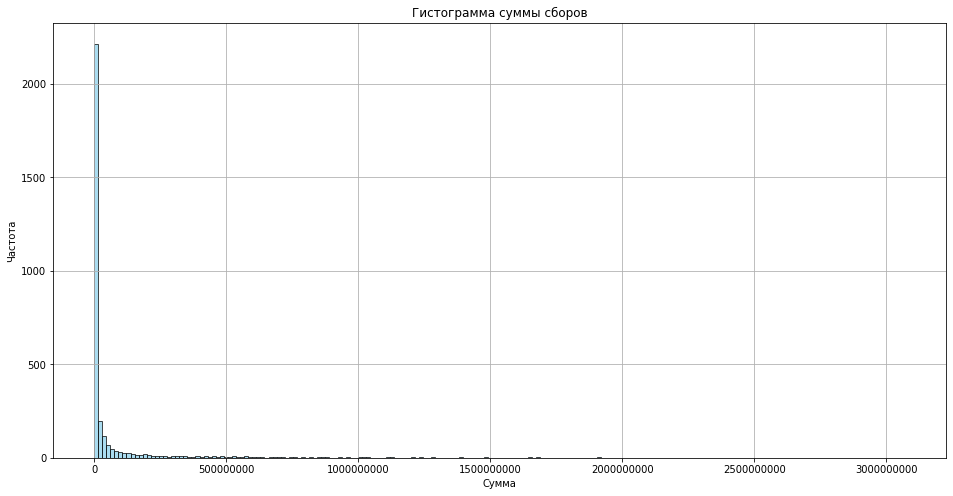

In [55]:
vid['box_office'].plot(kind='hist', 
                       bins=200, 
                       color='skyblue', 
                       edgecolor='black', 
                       alpha=0.7, 
                       figsize=(16, 8), 
                       grid=True)
# определяем формат, чтобы числа отображались в удобном виде
plt.ticklabel_format(style='plain', axis='x')
# добавляем названия к гистограмме
plt.xlabel('Сумма')
plt.ylabel('Частота')
plt.title('Гистограмма суммы сборов')
# выводим
plt.show()

<font color='DarkBlue'><b>Комментарий ревьюера</b></font><br>
<font color='DarkGreen'>👌 Хорошая визуализация и правильно, что оси подписаны и есть название графика.</font>

Громадный пик на низких значениях. 

In [56]:
vid.query('box_office < 25000 \
           and box_office > 1 \
           and production_country.str.contains("СССР", case=False, na=False)')

,title,pu_number,release_date,type,film_studio,production_country,director,producer,age_restriction,refundable_support,nonrefundable_support,budget,financing_source,ratings,genres,box_office,main_country
6,Любовь И Голуби,"111,007,013.00",2013-10-18,Художественный,"Киностудия ""Мосфильм""",СССР,В.Меньшов,NaN,«12+»,NaN,NaN,NaN,NaN,8.30,"мелодрама,комедия","2,700.00",СССР
18,Неподдающиеся,"111,003,616.00",2016-02-12,Художественный,"Киностудия ""Мосфильм""",СССР,Ю.Чулюкин,NaN,«6+»,NaN,NaN,NaN,NaN,8.00,"мелодрама,комедия",360.00,СССР
19,Неподсуден,"111,003,716.00",2016-02-12,Художественный,"Киностудия ""Мосфильм""",СССР,"В.Краснопольский, В.Усков",NaN,«6+»,NaN,NaN,NaN,NaN,7.70,драма,420.00,СССР
22,"Операция ""Ы"" И Другие Приключения Шурика","111,007,413.00",2013-10-18,Художественный,"Киностудия ""Мосфильм""",СССР,Л.Гайдай,NaN,«6+»,NaN,NaN,NaN,NaN,8.70,"комедия,мелодрама,криминал",380.00,СССР
38,Мужики!,"111,007,213.00",2013-10-18,Художественный,"Киностудия ""Мосфильм""",СССР,И.Бабич,NaN,«6+»,NaN,NaN,NaN,NaN,8.10,драма,"1,165.00",СССР
47,Андрей Рублев,"111,029,814.00",2014-12-24,Художественный,"Киностудия ""Мосфильм""",СССР,А.Тарковский,NaN,«12+»,NaN,NaN,NaN,NaN,8.20,"драма,биография,история","22,660.00",СССР
52,Айболит - 66,"111,010,513.00",2013-12-19,Художественный,"Киностудия ""Мосфильм""",СССР,Ролан Быков,NaN,«0+»,NaN,NaN,NaN,NaN,7.10,"мюзикл,комедия,детский","1,795.00",СССР
68,Алые Паруса,"111,010,913.00",2013-12-19,Художественный,"Киностудия ""Мосфильм""",СССР,А.Птушко,NaN,«6+»,NaN,NaN,NaN,NaN,7.80,"фэнтези,драма,мелодрама","1,850.00",СССР
75,Борис Годунов,"111,012,213.00",2013-12-19,Художественный,"Киностудия ""Мосфильм"", ""Баррандов"" (ЧССР) при...","СССР, ЧССР, Западный Берлин, ПНР",С.Бондарчук,NaN,«6+»,NaN,NaN,NaN,NaN,6.20,драма,420.00,СССР
78,Будьте Моим Мужем,"111,012,413.00",2013-12-19,Художественный,"Киностудия ""Мосфильм""",СССР,А.Сурикова,NaN,«6+»,NaN,NaN,NaN,NaN,6.40,комедия,200.00,СССР


Все кассовые сборы фильмов, выпущенных в СССР, могут быть указаны в советских рублях. Конечно, не совсем ясно, как с этими данными поступать. Однако, здесь есть хотя бы какие-то варианты и предположения: например, перевести на текущий рубль. Есть подсчеты третьих лиц и другая сторонняя информация. Но она, очевидно, сильно разнится от источника к источнику. Можем умножить на усредненное 200 и получить значения, примерно соответствующие текущему времени. А можем, ничего не делать и просто по случаю говорить, что это сборы в советских рублях. Либо обработать эти значения как выбросы.

In [57]:
vid.query('box_office < 25000 \
           and box_office > 1 \
           and not production_country.str.contains("СССР", case=False, na=False)')

,title,pu_number,release_date,type,film_studio,production_country,director,producer,age_restriction,refundable_support,nonrefundable_support,budget,financing_source,ratings,genres,box_office,main_country
61,Американская Дочь,"111,005,515.00",2015-04-23,Художественный,"АО ""Караван"", Компания ""Америкен Дистрибьюшн"",...","Россия, Казахстан, США",К.Шахназаров,NaN,«6+»,NaN,NaN,NaN,NaN,7.00,"драма,комедия",300.00,Россия
234,"Повар,Вор,Его Жена И Ее Любовник","221,059,612.00",2012-08-27,Художественный,"Эллартс Би Ви,Сине Электра 2 ЛТД",Великобритания,Питер Гринуэй,Кейс Кассандр,«18+»,NaN,NaN,NaN,NaN,7.60,"драма,криминал","7,800.00",Великобритания
255,Мученицы,"121,016,416.00",2016-06-07,Художественный,"Канал+, Уайлд Банч, ТСВ Фильм, Сине-Синема, Кр...",Канада-Франция,Паскаль Ложье,"Ришар Гранпьер, Симон Тротье",«18+»,NaN,NaN,NaN,NaN,6.40,ужасы,"18,600.00",Канада
336,Каникулы Строгого Режима,"111,008,514.00",2014-08-07,Художественный,"ООО ""Кинобазза"" по заказу ЗАО ""Дирекция Кино""",Россия,И.Зайцев,"А.Максимов, Н.Попов, Д.Файзиев",«12+»,NaN,NaN,NaN,NaN,7.10,"драма,комедия,приключения",360.00,Россия
351,Волшебное Приключение,"124,000,905.00",2015-01-18,Анимационный,"Экшион Филмз, Патэ Синема, Болексбразерс",Великобритания - Франция,Дэйв Бортвик,"Клауди Горский, Энди Лэйтон, Лаурен Родон, Пас...",«0+»,NaN,NaN,NaN,NaN,5.70,"мультфильм,фэнтези,комедия",100.00,Великобритания
436,Искатели Могил,"121,004,112.00",2012-02-15,Художественный,Диджитал Интерференс,США,Вишес Бразерс,"Сван Анджелски, Майкл Карлин",«16+»,NaN,NaN,NaN,NaN,6.40,"ужасы,триллер",550.00,США
462,Август. Восьмого,"111,000,612.00",2012-02-07,Художественный,"ЗАО ""ПК ""ГЛАВКИНО""",Россия,Д.Файзиев,"Д.Файзиев, Ф.Бондарчук, И.Бачурин",«12+»,NaN,NaN,NaN,NaN,6.10,"драма,военный","6,775.00",Россия
463,Тот Еще...!,"111,001,612.00",2012-02-20,Художественный,"ООО ""Энджой мувиз""",Россия,С.Андреасян,Г.Малков,«12+»,NaN,NaN,NaN,NaN,2.60,"фэнтези,комедия,семейный","12,779.00",Россия
464,Кококо,"111,003,112.00",2012-06-05,Художественный,"ООО Кинокомпания ""Глобус-фильм""",Россия,А.Смирнова,С.Сельянов,«18+»,NaN,NaN,NaN,NaN,6.90,"драма,комедия",200.00,Россия
470,Сделка,"111,000,912.00",2012-02-08,Художественный,"ООО ""Студия Продюсерского Кино""",Россия,А.Силкин,"В.Зверев, М.Линьков",«16+»,NaN,NaN,NaN,NaN,6.80,"ужасы,фэнтези,боевик","13,350.00",Россия


Есть много неадекватных значений. И здесь хоть какого-то логического объяснения, как в случае с фильмами из СССР, найти не получается. Можем, например, удалить значения ниже определенного уровня, тем самым сделав "порог входа". Посмотрим на гистограмму еще раз, но теперь ограничим значения текущей медианой.

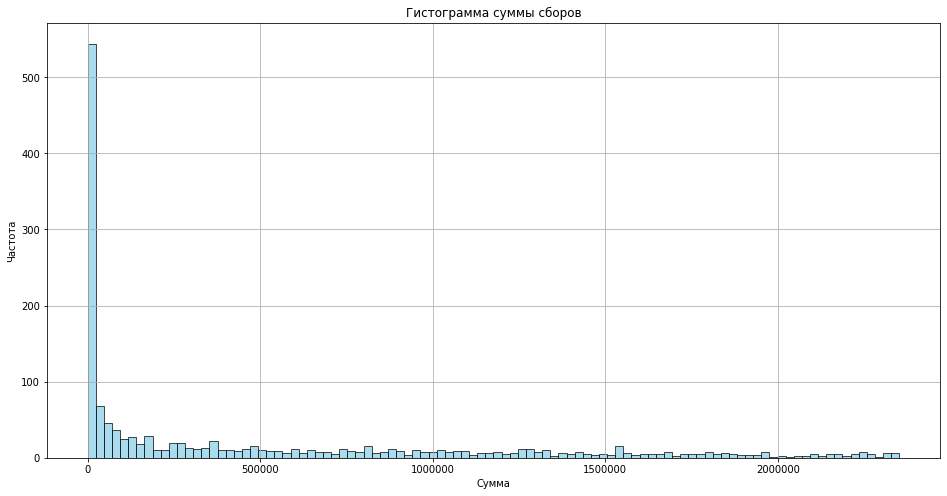

In [58]:
vid.query('box_office < 2352000 \
           and box_office > 1 \
           and not production_country.str \
                                     .contains("СССР", case=False, na=False)')['box_office'].plot(kind='hist', 
                                                                                                  bins=100, 
                                                                                                  color='skyblue', 
                                                                                                  edgecolor='black', 
                                                                                                  alpha=0.7, 
                                                                                                  figsize=(16, 8), 
                                                                                                  grid=True)
# определяем формат, чтобы числа отображались в удобном виде
plt.ticklabel_format(style='plain', axis='x')
# добавляем названия к гистограмме
plt.xlabel('Сумма')
plt.ylabel('Частота')
plt.title('Гистограмма суммы сборов')
# выводим
plt.show()

Все еще виден пик на низких значениях. Много около нуля. Выведем количество значений меньше 10 тысяч.

In [59]:
vid.query('box_office < 10000')['box_office'].count()

536

Теперь, выведем количество значений, равных нулю.

In [60]:
vid.query('box_office == 0')['box_office'].count()

23

Все значения равные нулю можем заменить пропущенными значениями. Но это позже.

Время абстрактных логических размышлений: средние сборы одного сеанса — 2000 рублей. Средний срок проката — 14 дней. В день, допустим, проект показывают 4 раза. Минимум, в 30 кинотеатрах. 2000 * 4 * 30 * 14 = 3360000. Предположим, минимальные сборы — 500000 рублей. 

In [61]:
vid.query('box_office < 500000 \
           and box_office > 1 \
           and not production_country.str \
                                     .contains("СССР", case=False, na=False)')['box_office'].count()

969

In [62]:
vid.query('box_office < 500000 \
           and box_office > 1')['box_office'].count()

1045

При удалении исчезнет слишком большой объем информации. Так не пойдет, 1/3 — это очень много. Что делать с этими данными — вопрос. По-хорошему, их, наверное, стоит удалить, чтобы нормализовать значения, получаемые функцией `.describe()`, тем самым увеличить точность последующих расчетов и релевантность выводов. Но я не уверен, что это лучшее решение. Порой, бездействие — тоже действие. Оставим как есть.

Мы рассмотрели столбец `'box_office'`. Еще чуть ранее рассмотрели столбец `'ratings'` и удалили в нем неадекватные значения. Значит, остались: `'refundable_support'`, `'nonrefundable_support'`, `'budget'`. Посмотрим, как соотносятся столбцы государственной поддержки с общим бюджетом фильма. Для этого, сначала создадим некоторый фильтр, который позволит нам не отвлекаться на пропущенные значения.

In [63]:
filtered_vid = vid[(vid['budget'].notna()) \
                 & (vid['refundable_support'].notna()) \
                 & (vid['nonrefundable_support'].notna())]
filtered_vid

,title,pu_number,release_date,type,film_studio,production_country,director,producer,age_restriction,refundable_support,nonrefundable_support,budget,financing_source,ratings,genres,box_office,main_country
1281,Пока Еще Жива,"111,005,313.00",2013-10-11,Художественный,"АНО содействия развитию кинематографии ""Ангел-...",Россия,А.Атанесян,"А.Атанесян, М.Бабаханов, Р.Бутко",«16+»,0.00,"26,500,000.00","79,411,900.00",Министерство культуры,8.10,"драма,мелодрама","365,353.60",Россия
1448,Бесславные Придурки,"111,003,314.00",2014-03-28,Художественный,"ООО ""Компания ""АТК-Студио""",Россия,А.Якимчук,А.Тютрюмов,«12+»,0.00,"26,000,000.00","37,142,857.00",Министерство культуры,NaN,NaN,"28,140.00",Россия
1498,Невидимки,"111,004,213.00",2013-09-10,Художественный,"ООО ""Компания ""РЕАЛ-ДАКОТА""",Россия,"Р.Давлетьяров, С.Комаров","Р.Давлетьяров, А.Котелевский, А.Олейников",«12+»,0.00,"107,847,945.00","176,023,490.00",Фонд кино,5.30,"комедия,фантастика","19,957,031.50",Россия
1524,Берцы,"111,004,314.00",2014-05-05,Художественный,"ООО ""Студия ""Пассажир""",Россия,Е.Миндадзе (псевдоним Катя Шагалова),Л.Антонова,«16+»,0.00,"28,000,000.00","40,574,140.00",Министерство культуры,4.20,драма,"55,917.50",Россия
1792,Братья Ч,"111,004,414.00",2014-04-23,Художественный,"ООО ""Студия ""Пассажир""",Россия,М.Угаров,"А.Миндадзе, Л.Антонова",«16+»,0.00,"25,000,000.00","40,015,122.00",Министерство культуры,6.40,драма,"232,100.00",Россия
1853,Тайна Сухаревой Башни. Чародей Равновесия,"114,000,115.00",2015-02-18,Анимационный,"ООО ""Студия ""Мастер-Фильм""",Россия,С.Серегин,А.Герасимов,«6+»,0.00,"25,000,000.00","51,850,000.00",Министерство культуры,6.10,"мультфильм,фэнтези,история","15,078,858.60",Россия
1869,А Зори Здесь Тихие,"111,002,915.00",2015-03-16,Художественный,"ООО ""Компания ""Реал-Дакота""",Россия,Р.Давлетьяров,NaN,«12+»,"50,000,000.00","100,000,000.00","220,588,394.00",Фонд кино,8.50,"драма,военный,история","249,166,767.70",Россия
1870,Две Женщины,"111,013,714.00",2014-10-02,Художественный,"ООО ""Продюсерский Центр ""Хорошо Продакшн"", Rez...","Россия, Франция, Латвия",В.Глаголева,Н.Иванова,«12+»,0.00,"46,502,299.00","86,210,067.00","Министерство культуры, Фонд кино",6.70,драма,"4,731,239.50",Россия
1902,Призрак,"111,001,815.00",2015-03-02,Художественный,"ООО ""Водород 2011""",Россия,А.Войтинский,С.Сельянов,«6+»,0.00,"75,000,000.00","139,551,503.00",Фонд кино,7.00,"триллер,боевик,приключения","352,804,320.40",Россия
1911,Ведьма,"111,002,215.00",2015-03-05,Художественный,"ООО ""Кинокомпания ""Ракурс""",Россия,Д.Федоров,В.Сидоренко,«16+»,0.00,"34,000,000.00","48,571,430.00",Министерство культуры,7.40,"фэнтези,приключения,драма","51,907.50",Россия


Видим, что есть неудобные строки: информация о финансовой поддержке присутствует, а о бюджете проекта — нет. Создадим гистограмму для наглядности.

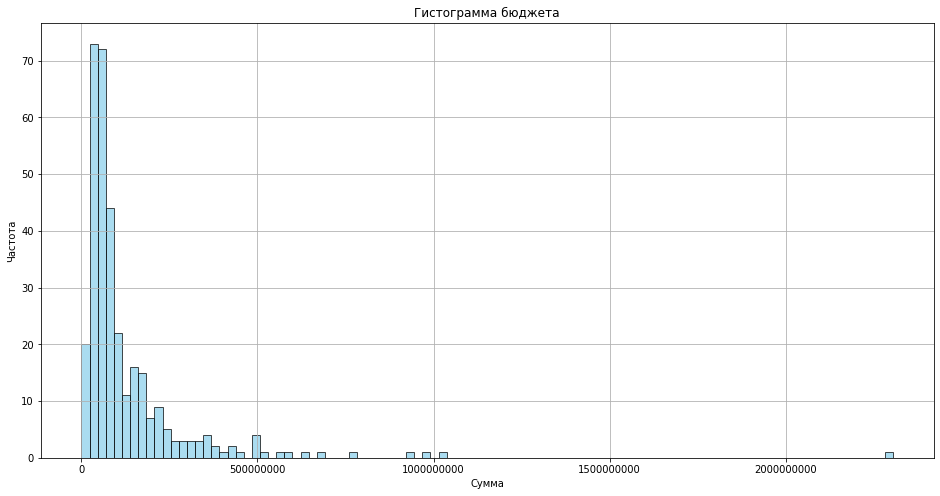

In [64]:
filtered_vid['budget'].plot(kind='hist', 
                            bins=100, 
                            color='skyblue', 
                            edgecolor='black', 
                            alpha=0.7, 
                            figsize=(16, 8),
                            grid=True)
# определяем формат, чтобы числа отображались в удобном виде
plt.ticklabel_format(style='plain', axis='x')
# добавляем названия к гистограмме
plt.xlabel('Сумма')
plt.ylabel('Частота')
plt.title('Гистограмма бюджета')
# выводим 
plt.show()

Гистограмма интересно растянулась. Посмотрим, что за фильм с таким бюджетом.

In [65]:
filtered_vid.describe()

,pu_number,refundable_support,nonrefundable_support,budget,ratings,box_office
count,330.00,330.00,330.00,330.00,314.00,316.00
mean,"111,597,348.21","11,936,363.64","49,233,297.92","127,835,768.11",6.00,"133,267,004.60"
std,"5,720,158.20","24,974,945.34","60,073,639.80","188,996,337.04",1.12,"335,733,734.01"
min,"111,000,115.00",0.00,0.00,0.00,1.00,"1,550.00"
25%,"111,004,916.50",0.00,"25,000,000.00","42,404,381.75",5.30,"1,272,646.25"
50%,"111,010,367.00",0.00,"30,000,000.00","69,118,977.00",6.20,"16,390,500.50"
75%,"111,017,715.25","15,000,000.00","41,125,000.00","145,905,958.50",6.70,"106,934,534.82"
max,"214,010,116.00","180,000,000.00","400,000,000.00","2,305,074,303.00",8.50,"3,073,568,690.79"


In [66]:
filtered_vid.query('budget > 2000000000')

,title,pu_number,release_date,type,film_studio,production_country,director,producer,age_restriction,refundable_support,nonrefundable_support,budget,financing_source,ratings,genres,box_office,main_country
7113,Тайна Печати Дракона,"111,012,819.00",2019-09-12,Художественный,"ООО ""Кинокомпания ""СТВ""; ООО ""РФГ Корп""; ООО ""...",Россия-Китай,О.Степченко,"С.Сельянов, А.Петрухин",«6+»,"180,000,000.00","90,000,000.00","2,305,074,303.00",Фонд кино,5.80,"приключения,фэнтези","333,597,059.59",Россия


Интересно... И грустно.

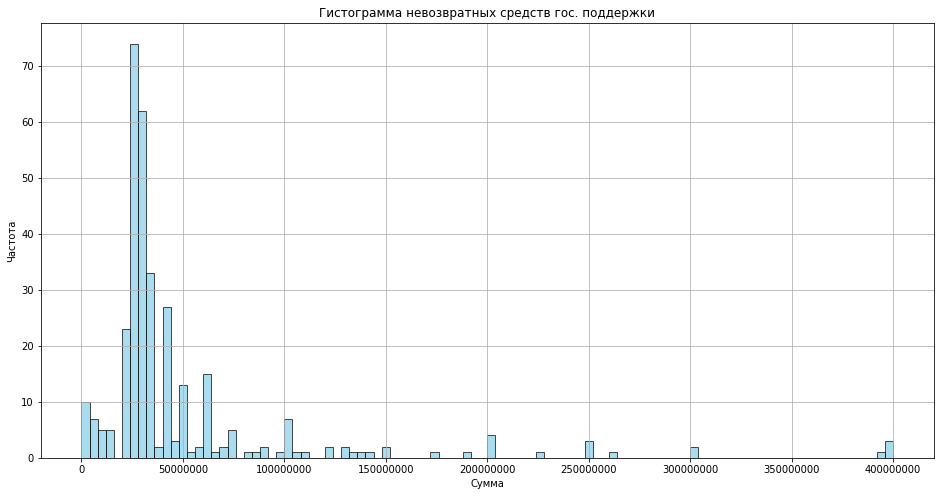

In [67]:
filtered_vid['nonrefundable_support'].plot(kind='hist', 
                                           bins=100, 
                                           color='skyblue', 
                                           edgecolor='black', 
                                           alpha=0.7, 
                                           figsize=(16, 8), 
                                           grid=True)
# определяем формат, чтобы числа отображались в удобном виде
plt.ticklabel_format(style='plain', axis='x')
# добавляем названия к гистограмме
plt.xlabel('Сумма')
plt.ylabel('Частота')
plt.title('Гистограмма невозвратных средств гос. поддержки')
# выводим
plt.show()

Что занимательно, здесь пика на нуле или около низких значений нет. Невозвратные средства в больших объемах — нередкий случай.

In [68]:
filtered_vid.query('nonrefundable_support > 320000000')

,title,pu_number,release_date,type,film_studio,production_country,director,producer,age_restriction,refundable_support,nonrefundable_support,budget,financing_source,ratings,genres,box_office,main_country
2919,Экипаж,"111,005,416.00",2016-03-21,Художественный,"ООО ""Студия ""ТРИТЭ"" Никиты Михалкова""",Россия,Н.Лебедев,"Л.Верещагин, А.Златопольский, Н.Михалков, ООО ...",«6+»,"50,000,000.00","392,104,482.00","635,283,867.00",Фонд кино,7.60,"драма,триллер,приключения","1,402,255,390.00",Россия
5652,Движение Вверх,"111,011,817.00",2017-12-21,Художественный,"ООО ""Студия ""ТРИТЭ"" Никиты Михалкова""",Россия,А.Мегердичев,"Л.Верещагин, А.Златопольский, Н.Михалков, ООО ...",«6+»,0.00,"400,000,000.00","590,192,191.00",Фонд кино,7.50,"спорт,драма","2,779,686,144.00",Россия
7463,Союз Спасения,"111,022,019.00",2019-12-26,Художественный,"ЗАО ""Дирекция кино""",Россия,А.Кравчук,"А.Максимов, К.Эрнст",«12+»,"100,000,000.00","400,000,000.00","980,000,000.00",Фонд кино,6.00,"история,биография,драма","717,703,185.53",Россия
7473,Вторжение,"111,022,519.00",2019-12-23,Художественный,"ООО ""Арт Пикчерс Студия"", ООО ""Водород 2011""",Россия,Ф.Бондарчук,"Ф.Бондарчук, М.Врубель, А.Андрющенко, Д.Рудовский",«12+»,"100,000,000.00","400,000,000.00","944,000,000.00",Фонд кино,5.70,"фантастика,боевик",NaN,Россия


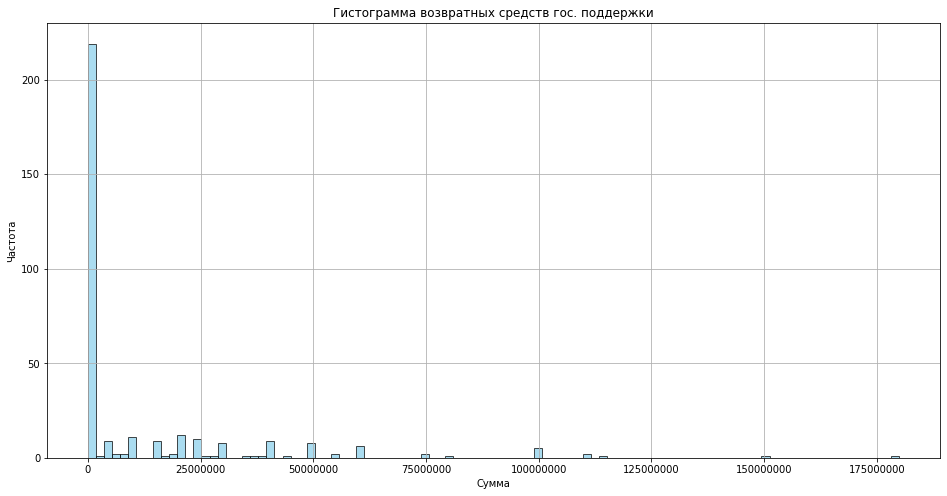

In [69]:
filtered_vid['refundable_support'].plot(kind='hist', 
                                        bins=100, 
                                        color='skyblue', 
                                        edgecolor='black', 
                                        alpha=0.7, 
                                        figsize=(16, 8),  
                                        grid=True)
# определяем формат, чтобы числа отображались в удобном виде
plt.ticklabel_format(style='plain', axis='x')
# добавляем названия к гистограмме
plt.xlabel('Сумма')
plt.ylabel('Частота')
plt.title('Гистограмма возвратных средств гос. поддержки')
# выводим
plt.show()

Здесь ситуация кардинально противоположная. Если "донаты" — в порядке вещей, то "кредиты" — исключительные случаи.

In [70]:
# выведем количество проектов с безвозвратными вложениями
vid.query('nonrefundable_support != 0')['nonrefundable_support'].count()

321

In [71]:
# выведем количество проектов с возвратными вложениями
vid.query('refundable_support != 0')['refundable_support'].count()

111

In [72]:
# выведем количество проектов "без бюджета"
filtered_vid.query('budget == 0')['title'].count()

17

У нас есть 17 строк, где бюджет равен нулю. Не будет хуже, если мы заполним нулевой бюджет суммой обоих видов государственной поддержки.

In [73]:
vid.loc[vid['budget'] == 0, 'budget'] = vid['refundable_support'] + vid['nonrefundable_support']

Кроме того, чтобы улучшить вид гистограммы и увеличить достоверность данных, заменим нулевые значения в столбцах поддержки на пропущенные значения. Просто будем иметь в виду, что пропущенные значения значат, что определенный тип поддержки отсутствует. Но здесь важный момент: мы не должны работать с оригинальным датасетом. Поэтому, создадим специальную копию для анализа. Если же мы заменим значения на пропущенные в оригинале, то мы потеряем возможность проводить вычисления в дальнейшем. 

In [74]:
zero2nan = vid.copy()
zero2nan[['refundable_support', 'nonrefundable_support']] = (
    zero2nan[['refundable_support', 
                          'nonrefundable_support']].replace(0, np.nan)
)
zero2nan['box_office'] = zero2nan['box_office'].replace(0, np.nan)

Проверим, насколько изменились показатели и гистограммы.

In [75]:
zero2nan[quan_cols].describe()

,refundable_support,nonrefundable_support,budget,ratings,box_office
count,111.00,321.00,330.00,"6,484.00","3,118.00"
mean,"35,486,486.49","50,613,670.75","132,053,857.39",6.48,"77,286,255.36"
std,"31,972,875.36","60,334,540.85","187,536,651.42",1.10,"241,603,227.65"
min,"3,500,000.00","3,000,000.00","6,000,000.00",1.00,40.00
25%,"15,000,000.00","25,000,000.00","46,153,856.25",5.90,"103,007.50"
50%,"25,000,000.00","30,000,000.00","72,448,592.50",6.60,"2,440,951.85"
75%,"50,000,000.00","45,000,000.00","150,000,000.00",7.20,"24,828,375.52"
max,"180,000,000.00","400,000,000.00","2,305,074,303.00",9.20,"3,073,568,690.79"


Картина сильно преобразилась! Теперь, медиана по кредиту — 25 миллионов вместо нуля. Минимальный бюджет — 6 миллионов. Построим гистограммы.

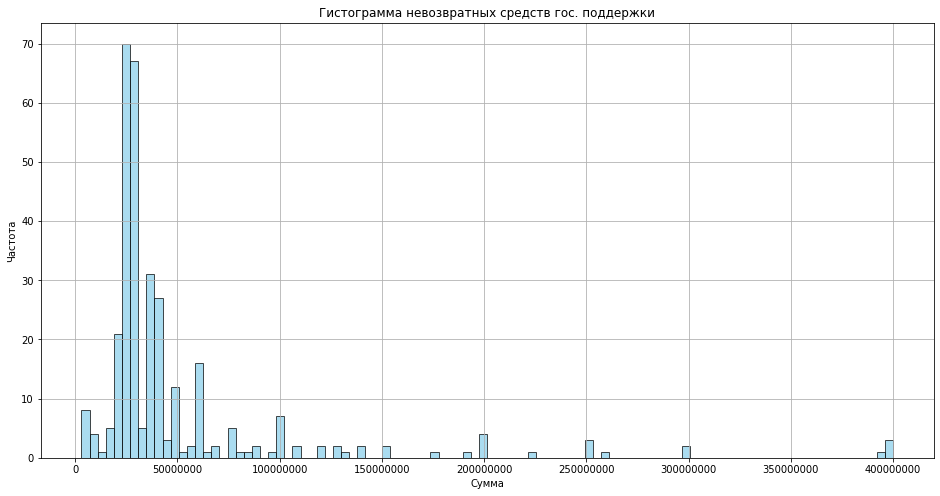

In [76]:
zero2nan['nonrefundable_support'].plot(kind='hist', 
                                           bins=100, 
                                           color='skyblue', 
                                           edgecolor='black', 
                                           alpha=0.7, 
                                           figsize=(16, 8), 
                                           grid=True)
# определяем формат, чтобы числа отображались в удобном виде
plt.ticklabel_format(style='plain', axis='x')
# добавляем названия к гистограмме
plt.xlabel('Сумма')
plt.ylabel('Частота')
plt.title('Гистограмма невозвратных средств гос. поддержки')
# выводим
plt.show()

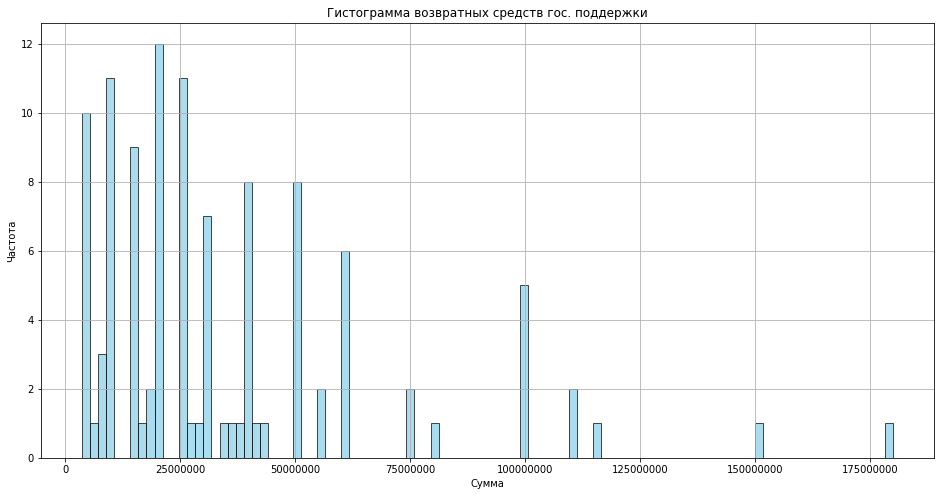

In [77]:
zero2nan['refundable_support'].plot(kind='hist', 
                                        bins=100, 
                                        color='skyblue', 
                                        edgecolor='black', 
                                        alpha=0.7, 
                                        figsize=(16, 8),  
                                        grid=True)
# определяем формат, чтобы числа отображались в удобном виде
plt.ticklabel_format(style='plain', axis='x')
# добавляем названия к гистограмме
plt.xlabel('Сумма')
plt.ylabel('Частота')
plt.title('Гистограмма возвратных средств гос. поддержки')
# выводим
plt.show()

Гистограммы тоже сильно преобразились.

**Что мы сделали?** Проанализировали `'refundable_support'`, `'nonrefundable_support'`, `'budget'`, `'ratings'`, `'box_office'` и значения в них. Обработали аномалии в каждом из столбцов: так, например, во всех столбцах кроме рейтинга мы избавились от мешающих анализу нулей и заменили их пропущенными значениями. Это было сделано для того, чтобы лучше понять статистическое описание столбцов. Мы не стали работать с датасетом целиком, поскольку это усложнило бы дальнейший анализ. 

**Что мы имеем в итоге, какие мысли?** Гистограммы и описание для значений по столбцам показывают: 111 случая выдачи кредита, 321 случая невозвратной помощи. Это говорит о том, что кредиты выдают реже, а донаты — чаще. Кроме того, хоть медиана кредита близка к медиане доната — 25 миллонов против 30 миллионов рублей, то про среднее так сказать уже не получится — 35 миллионов против 50 миллионов рублей. Максимальный донат — 400 миллионов, довольно щедро. А вот кредит — всего 180 миллионов.

**Почему могли появиться нули в датасете?** В столбцах о финансовой поддержки это, скорее всего, говорит о том, что поддержки просто не было. Нули в бюджете — отсутствующие данные. Это могло произойти по разным причинам и ответственным за это может быть и человек, и машина, и простая случайность.

### Новые столбцы

Создадим столбец с информацией о годе проката и выделим год из даты премьеры фильма. Далее, создадим два столбца: с именем и фамилией главного режиссера, основным жанром фильма. 



In [78]:
vid['release_year'] = vid['release_date'].dt.year
vid['release_year'].head(3)

0    2015
1    2016
2    2016
Name: release_year, dtype: int64

Теперь, мы имеем столбец с годом даты премьеры. Отлично. Теперь приведем в порядок значения в столбце `'director'`.

In [79]:
vid['director'] = (vid['director'].str
                                  .replace(r'\.(\w)', r'. \1', regex=True)
)

Теперь, создадим функцию (на подобие той, что мы уже делали), которая позволит нам разделить главного режиссера от остальных, а также главный жанр от сопутствующих.

In [80]:
# извлекает первое значение из списка с разделителем в лице запятой
def extract_first_value(column):
    return column.str.split(',').str[0]
# применяем функцию при создании столбцов
vid['main_director'] = extract_first_value(vid['director'])
vid['main_genre'] = extract_first_value(vid['genres'])

In [81]:
vid.head(3)

,title,pu_number,release_date,type,film_studio,production_country,director,producer,age_restriction,refundable_support,nonrefundable_support,budget,financing_source,ratings,genres,box_office,main_country,release_year,main_director,main_genre
0,Открытый Простор,"221,048,915.00",2015-11-27,Художественный,"Тачстоун Пикчерз, Кобальт Пикчерз, Бикон Пикче...",США,Кевин Костнер,"Дэвид Валдес, Кевин Костнер, Джейк Эбертс",«18+»,NaN,NaN,NaN,NaN,7.20,"боевик,драма,мелодрама",NaN,США,2015,Кевин Костнер,боевик
1,Особо Важное Задание,"111,013,716.00",2016-09-13,Художественный,"Киностудия ""Мосфильм""",СССР,Е. Матвеев,NaN,«6+»,NaN,NaN,NaN,NaN,6.60,"драма,военный",NaN,СССР,2016,Е. Матвеев,драма
2,Особо Опасен,"221,038,416.00",2016-10-10,Художественный,"Юниверсал Пикчерз, Кикстарт Продакшнз, Марк Пл...",США,Тимур Бекмамбетов,"Джим Лемли, Джейсон Нетер, Марк Е.Платт, Яйн Смит",«18+»,NaN,NaN,NaN,NaN,6.80,"фантастика,боевик,триллер",NaN,США,2016,Тимур Бекмамбетов,фантастика


Отлично! Посчитаем, какую долю от общего бюджета фильма составляет государственная поддержка.

In [82]:
# считаем сумму общей поддержки
vid['total_support'] = vid['refundable_support'] + vid['nonrefundable_support']
# считаем соотношение
vid['support_ratio'] = vid['total_support'] / vid['budget']

Выведем датафрейм с фильтром, чтобы не отвлекаться на пропущенные значения и долю равную единице (так произошло из-за того, что мы заполнили столбец с бюджетом суммой оказанной помощи).

In [83]:
vid

,title,pu_number,release_date,type,film_studio,production_country,director,producer,age_restriction,refundable_support,nonrefundable_support,budget,financing_source,ratings,genres,box_office,main_country,release_year,main_director,main_genre,total_support,support_ratio
0,Открытый Простор,"221,048,915.00",2015-11-27,Художественный,"Тачстоун Пикчерз, Кобальт Пикчерз, Бикон Пикче...",США,Кевин Костнер,"Дэвид Валдес, Кевин Костнер, Джейк Эбертс",«18+»,NaN,NaN,NaN,NaN,7.20,"боевик,драма,мелодрама",NaN,США,2015,Кевин Костнер,боевик,NaN,NaN
1,Особо Важное Задание,"111,013,716.00",2016-09-13,Художественный,"Киностудия ""Мосфильм""",СССР,Е. Матвеев,NaN,«6+»,NaN,NaN,NaN,NaN,6.60,"драма,военный",NaN,СССР,2016,Е. Матвеев,драма,NaN,NaN
2,Особо Опасен,"221,038,416.00",2016-10-10,Художественный,"Юниверсал Пикчерз, Кикстарт Продакшнз, Марк Пл...",США,Тимур Бекмамбетов,"Джим Лемли, Джейсон Нетер, Марк Е.Платт, Яйн Смит",«18+»,NaN,NaN,NaN,NaN,6.80,"фантастика,боевик,триллер",NaN,США,2016,Тимур Бекмамбетов,фантастика,NaN,NaN
3,Особо Опасен,"221,026,916.00",2016-06-10,Художественный,"Юниверсал Пикчерз, Кикстарт Продакшнз, Марк Пл...",США,Тимур Бекмамбетов,"Джим Лемли, Джейсон Нетер, Марк Е.Платт, Яйн Смит",«18+»,NaN,NaN,NaN,NaN,6.80,"фантастика,боевик,триллер",NaN,США,2016,Тимур Бекмамбетов,фантастика,NaN,NaN
4,Особо Опасен,"221,030,815.00",2015-07-29,Художественный,"Юниверсал Пикчерз, Кикстарт Продакшнз, Марк Пл...",США,Тимур Бекмамбетов,"Джим Лемли, Джейсон Нетер, Марк Е.Платт, Яйн Смит",«18+»,NaN,NaN,NaN,NaN,6.80,"фантастика,боевик,триллер",NaN,США,2015,Тимур Бекмамбетов,фантастика,NaN,NaN
5,Остановился Поезд,"111,013,816.00",2016-09-13,Художественный,"Киностудия ""Мосфильм""",СССР,В. Абдрашитов,NaN,«6+»,NaN,NaN,NaN,NaN,7.70,драма,NaN,СССР,2016,В. Абдрашитов,драма,NaN,NaN
6,Любовь И Голуби,"111,007,013.00",2013-10-18,Художественный,"Киностудия ""Мосфильм""",СССР,В. Меньшов,NaN,«12+»,NaN,NaN,NaN,NaN,8.30,"мелодрама,комедия","2,700.00",СССР,2013,В. Меньшов,мелодрама,NaN,NaN
7,Любовь И Сигареты,"221,074,614.00",2014-12-29,Художественный,"Юнайтед Артистс, Грин Стрит Филмз, Айкон Интер...",США,Джон Туртурро,"Джон Пенотти, Джон Туртурро",«18+»,NaN,NaN,NaN,NaN,6.60,"мюзикл,мелодрама,комедия",NaN,США,2014,Джон Туртурро,мюзикл,NaN,NaN
8,Отпетые Мошенники,"121,011,416.00",2016-05-05,Художественный,"Пульсар Продюксьон, ТФ1 Фильм",Франция,Эрик Беснард,Патрис Леду,«18+»,NaN,NaN,NaN,NaN,8.00,"комедия,криминал",NaN,Франция,2016,Эрик Беснард,комедия,NaN,NaN
9,Отпуск За Свой Счет,"111,019,114.00",2014-12-01,Художественный,"Киностудия ""Мосфильм"", Телевидение ВНР","СССР, Венгрия",В. Титов,NaN,«12+»,NaN,NaN,NaN,NaN,7.80,"мелодрама,комедия",NaN,СССР,2014,В. Титов,мелодрама,NaN,NaN


In [84]:
no_na_sr = vid.query('support_ratio != inf and support_ratio < 1 and not support_ratio.isna()').sort_values(by='support_ratio', ascending=False)
no_na_sr

,title,pu_number,release_date,type,film_studio,production_country,director,producer,age_restriction,refundable_support,nonrefundable_support,budget,financing_source,ratings,genres,box_office,main_country,release_year,main_director,main_genre,total_support,support_ratio
3384,О Любви (2017),"111,018,816.00",2016-12-28,Художественный,"ООО ""СТУДИЯ ""2-Б-2"" ИНТЕРТЭЙНМЕНТ""",Россия,В. Бортко,Н.Бортко,«16+»,"20,000,000.00","35,000,000.00","70,086,439.00","Министерство культуры, Фонд кино",NaN,NaN,"11,332,412.00",Россия,2016,В. Бортко,NaN,"55,000,000.00",0.78
2537,Наследники (2015),"111,018,515.00",2015-10-22,Художественный,"Культурный фонд ""Кино-телекомпания ""Православн...",Россия,В. Хотиненко,"С.Кравец, В.Хотиненко",«16+»,"7,153,119.00","28,000,000.00","50,218,741.00","Министерство культуры, Фонд кино",6.10,"мюзикл,фэнтези,комедия","194,780.00",Россия,2015,В. Хотиненко,мюзикл,"35,153,119.00",0.70
2898,Преображение (2015),"111,007,016.00",2016-04-08,Художественный,"ООО ""АБС""",Россия,"Т. Воронецкая, Д. Сергин",Е.Белова,«16+»,0.00,"26,000,000.00","37,142,857.00",Министерство культуры,5.70,ужасы,"56,800.00",Россия,2016,Т. Воронецкая,ужасы,"26,000,000.00",0.70
2378,Экспириенс,"111,000,315.00",2015-01-13,Художественный,"ООО ""Компания ""АТК-Студио""",Россия,Е. Татаров,А.Тютрюмов,«16+»,0.00,"26,000,000.00","37,142,857.00",Министерство культуры,4.70,драма,"36,550.00",Россия,2015,Е. Татаров,драма,"26,000,000.00",0.70
1448,Бесславные Придурки,"111,003,314.00",2014-03-28,Художественный,"ООО ""Компания ""АТК-Студио""",Россия,А. Якимчук,А.Тютрюмов,«12+»,0.00,"26,000,000.00","37,142,857.00",Министерство культуры,NaN,NaN,"28,140.00",Россия,2014,А. Якимчук,NaN,"26,000,000.00",0.70
3142,Завтра Утром,"111,021,715.00",2015-12-28,Художественный,"ООО ""Кинофабрика""",Россия,"А. Майовер, Д. Крылова","В.Рубан, А.Тельнов, А.Львович",«12+»,0.00,"35,000,000.00","50,000,000.00",Министерство культуры,5.70,"мелодрама,комедия,спорт","51,220.00",Россия,2015,А. Майовер,мелодрама,"35,000,000.00",0.70
3146,Память Осени,"111,000,516.00",2016-01-22,Художественный,"ООО ""Продюсерский центр ""Синема Продакшн""",Россия,А. Соколов,"Э.Айнулова, М.Журомская, А.Соколов",«16+»,"9,000,000.00","40,000,000.00","70,000,000.00","Министерство культуры, Фонд кино",5.70,драма,"58,500.00",Россия,2016,А. Соколов,драма,"49,000,000.00",0.70
1986,Елки Лохматые,"111,023,114.00",2014-12-10,Художественный,"ООО ""ТаББаК""",Россия,Максим Свешников,"Тимур Бекмамбетов, Евгения Аронова",«6+»,"26,000,000.00","30,000,000.00","80,000,000.00",Фонд кино,5.00,"семейный,комедия","121,225,633.80",Россия,2014,Максим Свешников,семейный,"56,000,000.00",0.70
2379,Ангелы Революции,"111,023,214.00",2014-12-11,Художественный,"ООО ""29 февраля""",Россия,А. Федорченко,"Д.Воробьев, А.Федорченко, Л.Лебедев",«16+»,0.00,"28,000,000.00","40,000,000.00",Министерство культуры,6.40,драма,"869,181.00",Россия,2014,А. Федорченко,драма,"28,000,000.00",0.70
2264,Клетка (По Мотивам Фантастического Рассказа Ф....,"111,015,314.00",2014-11-14,Художественный,"ООО Кинокомпания ""Фортуна Фильм"", ООО ""Центр Ю...",Россия,"Э. Архангельская, М. Пандурски","Э.Архангельская, А.Пискунова, Ю.Арабов",«16+»,0.00,"24,500,000.00","35,000,000.00",Министерство культуры,6.20,"драма,детектив","955,970.50",Россия,2014,Э. Архангельская,драма,"24,500,000.00",0.70


In [85]:
no_na_sr['support_ratio'].describe()

count   313.00
mean      0.52
std       0.17
min       0.04
25%       0.38
50%       0.59
75%       0.66
max       0.78
Name: support_ratio, dtype: float64

Среднее соотношение — 52%. Минимальное — 4%, максимальное — 78%. Медиана — 59%. Получается, государство довольно активно поддерживает кинопроизводство.

### Вывод по второму этапу

Исправили типы столбцов `'release_date'`, `'ratings'`, удалили в последнем значения другого стиля (в процентах); изучили пропуски в датафрейме, заполнили пропуски в `'film_studio'` заглушкой `no_studio`, поскольку, вероятнее всего, за пропусками скрывалось простое отсутствие работы с киностудией. Удалили пропущенные значения в `'production_country'` & `'director'`. Поработали с явными дубликатами в столбцах `'title'` & `'pu_number'`. Поработали с категориальными столбцами, где была одна и та же ошибка записи значений. Где-то они были записаны с добавлением ненужных символов, например " Художественный" с пробелом перед словом. Кроме того, еще одной общей проблемой были образовавшиеся кластеры значений, которые не поддаются разъединению. В ходе обработки `'production_country'` мы сделали отдельный новый столбец с основной страной производства проекта и заменили в ней неправильные значения. Например: значение "2019" было заменено на "Германия". Узнали о той же проблеме кластеров в столбцах `'director'`, `'producer'`, `'genres'`. Привели в лучший вид столбец `'age_restrictions'` путем удаления дополнительных сведений об ограничении. Проверили количественные значения, в ходе которых были выявлены аномальные значения в столбцах `'box_office'` `'nonrefundable_support'`, `'refundable_support'`, `'budget'`. Во всех этих столбцах была решена проблема с нулевым значением. В столбце с бюджетом, нули были заменены на сумму поддержек в случае имения таковой, а в остальных — пропущенными значениями. Это позволило сильно сдвинуть численные показатели и улучшить вид гистограмм. Были добавлены новые столбцы с главной информацией о режиссере и основным жанром проекта. Еще, был добавлен столбец с рассчитанной долей государственной поддержки от общего бюджета фильма.

<a id="item-three"></a>
## Исследовательский анализ данных

### Ежегодный прокат. Доли и лучшее время
Посмотрим, сколько фильмов выходило в прокат каждый год. Будем держать в голове, что данные о прокате в кинотеатрах известны не для всех фильмов. Посчитаем, какую долю составляют фильмы с указанной информацией о прокате в кинотеатрах. Затем, проанализируем, как эта доля менялась по годам. 

In [86]:
# создаем фильтр для фильмов с информацией о прокате
vid_box = vid[vid['box_office'].notna()]
# считаем фильмы с фильтром
vid_year_count = pd.pivot_table(vid_box, 
                                index='release_year',
                                values='title',
                                aggfunc='count')
# считаем вообще все фильмы
total_vid_year_count = pd.pivot_table(vid,
                                      index='release_year',
                                      values='title',
                                      aggfunc='count')

# считаем пропорцию фильмов с информацией о кинопрокате
ratio_by_year = vid_year_count / total_vid_year_count
# выводим информацию
pd.concat([vid_year_count, total_vid_year_count, ratio_by_year], axis=1, keys=['В прокате', 'Всего', 'Пропорция'])

,В прокате,Всего,Пропорция
,title,title,title
release_year,,,
2010,105,977,0.11
2011,109,619,0.18
2012,126,590,0.21
2013,184,628,0.29
2014,278,805,0.35
2015,460,697,0.66
2016,522,812,0.64
2017,356,503,0.71


Получившиеся пропорции показывают, что датасет может считаться репрезентативным только для фильмов, вышедшим в прокат после 2015 (включительно). До этого, пропорции слишком низкие. Наиболее представленный год — 2017. За ним — 2015, 2016, 2019, 2018. Такой вот топ-5. 

### Динамика проката, среднее и медиана сборов
Изучим, как менялась динамика проката по годам. Посмотрим, в каком году сумма сборов была минимальной и максимальной. С помощью сводной таблицы посчитаем среднюю и медианную сумму сборов для каждого года.

In [87]:
bo_pvt = pd.pivot_table(vid, 
                        values='box_office',
                        index='release_year',
                        aggfunc=['sum', 'mean', 'median'])
bo_pvt.columns = ['Сумма', 'Среднее', 'Медиана']
bo_pvt

,Сумма,Среднее,Медиана
release_year,,,
2010,"2,428,654.00","23,130.04","1,700.00"
2011,"14,102,765.00","129,383.17","3,000.00"
2012,"6,909,333.00","54,835.98","5,660.00"
2013,"29,799,706.20","161,954.92","3,522.50"
2014,"7,444,947,564.20","26,780,386.92","18,885.00"
2015,"38,966,066,659.70","84,708,840.56","5,003,450.15"
2016,"47,862,730,029.91","91,691,053.70","4,002,836.25"
2017,"48,563,669,257.51","136,414,801.29","10,177,833.50"
2018,"49,666,815,912.81","104,782,312.05","8,911,533.94"


Максимальная сумма сборов — в 2018, минимальная среди нашего топ-5 — 2015. Наибольшие средние сборы — в 2017. Там же наибольшее среднее и медиана. В столбце `'box_office'` с самого начала было ненормально большое стандартное отклонение. Проанализируем данные по 2017 году.

Сумма кассовых сборов: общая сумма в 48.56 миллиарда рублей указывает на общий объем выручки от фильмов за 2017 год. Это важный показатель экономического успеха кинематографической индустрии. Она почти на 10 миллиардов превышает показатель за 2015 год.

Среднее кассовых сборов: средний сбор на фильм в размере 136 миллионов рублей может служить ориентиром для оценки среднего успеха большого фильма в монетарном выражении. 

Медиана кассовых сборов: медиана в размере 10 миллионов рублей указывает на то, что половина фильмов имеют сборы в этом диапазоне или ниже. Это позволяет лучше понять "типичный" уровень кассовых сборов.

Такая сильная разница между суммой и медианой может указывать на наличие числа фильмов с чрезвычайно высокими кассовыми сборами. Это и влияет на среднее значение.
Для более подробного анализа данных полезно рассмотреть распределение кассовых сборов. Построим диаграмму размаха.

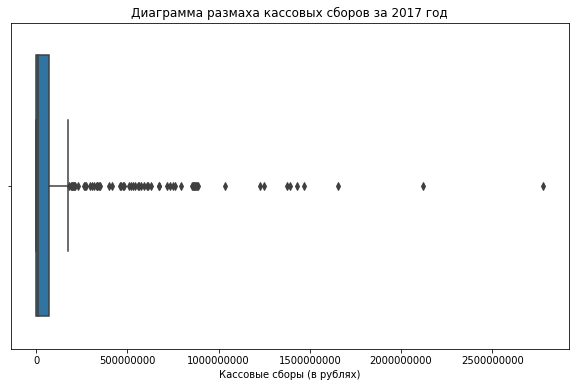

In [88]:
# Построение диаграммы размаха
plt.figure(figsize=(10, 6))
sns.boxplot(x='box_office', data=vid[vid['release_year'] == 2017])
# определяем формат, чтобы числа отображались в удобном виде
plt.ticklabel_format(style='plain', axis='x')
# Настройка заголовка и меток осей
plt.title('Диаграмма размаха кассовых сборов за 2017 год')
plt.xlabel('Кассовые сборы (в рублях)')

# Отображение диаграммы
plt.show()

In [89]:
vid.query('release_year == 2017')['box_office'].describe()

count             356.00
mean      136,414,801.29
std       323,625,698.20
min             7,900.00
25%         2,010,992.25
50%        10,177,833.50
75%        72,319,114.25
max     2,779,686,144.00
Name: box_office, dtype: float64

Стандартное отклонение все еще велико. Среднее растянулось так сильно потому, что был невероятных масштабов проект со сборами почти в 3 миллиарда рублей. С учетом вида диаграммы и данных о последнем квартиле, можно подумать, что медиана все еще является более репрезентативной мерой.

### Возрастное ограничение и сборы
Определим, влияет ли возрастное ограничение аудитории на сборы фильма в прокате в период с 2015 по 2019 год. Фильмы с каким возрастным ограничением собрали больше всего денег в прокате? Меняется ли картина в зависимости от года? Если да, предположим, с чем это может быть связано.

In [90]:
# создаем небольшой фильтр
year_filter_vid = vid[(vid['release_year'] >= 2015)]
# создаем сводную таблицу, чтобы оценить импакт возрастных ограничений 
age_restriction_analysis = pd.pivot_table(year_filter_vid, 
                                          index='age_restriction', 
                                          values='box_office',
                                          columns='release_year',
                                          aggfunc='sum')
# выводим табличку
display(age_restriction_analysis)
# наиболее профитное ограничение
age_restriction_analysis.sum(axis=1).idxmax()

release_year,2015,2016,2017,2018,2019
age_restriction,,,,,
«0+»,"379,054,578.37","150,034,321.67","229,598,930.00","32,449,002.11","17,746,066.82"
«12+»,"13,616,082,008.91","12,204,446,524.39","7,851,389,700.67","14,267,291,660.69","12,680,198,773.67"
«16+»,"11,367,319,500.27","16,664,465,701.74","18,745,042,900.06","16,503,602,346.96","12,748,819,511.65"
«18+»,"5,430,878,508.44","6,790,637,473.87","9,651,495,581.02","8,758,498,279.64","10,121,796,303.64"
«6+»,"8,172,732,063.71","12,053,146,008.24","12,086,142,145.76","10,104,974,623.41","12,852,513,658.86"


'«16+»'

Возрастное ограничение, несомненно, влияет на сборы фильмов. Наименьший профит получают проекты, выходящие без ограничений (0+). Наибольший — 16+. Это может быть связано с "всепогодностью" похожего ограничения. Он охватывает самое широкое количество потенциальных зрителей, что, собственно, сказывается на его сборах. Из-за экстенсивной направленности, на проект с ограничением в 16+ могут попасть все желающие. Помимо того, если ограничение все же стоит, значит фильм не является детским, что автоматически делает его "более привлекательным" в глазах взрослой аудитории. Ограничение в 16+ проиграло другим ограничениям по сборам лишь дважды — в 2015 и 2019 году. В первом случае, большее количество сборов получили проекты с ограничением в 12+, а в 2019 — 6+.

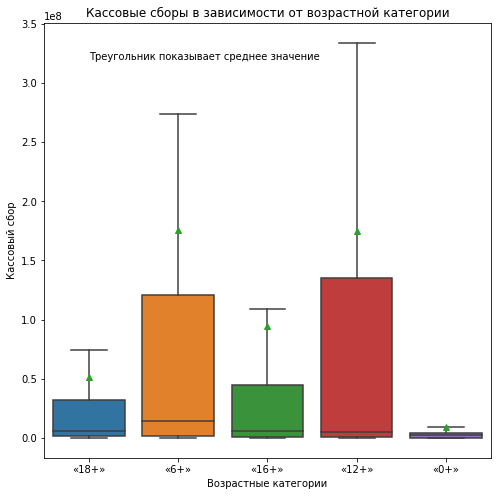

In [100]:
# Комментарий ревьюера 2
import seaborn as sns
temp = vid.copy()
# сохраним маску для среза по годам
year_mask = temp['release_year'] >= 2015

plt.figure(figsize=(8, 8))
(sns.boxplot(data = temp.loc[year_mask], y = 'box_office', x='age_restriction', showfliers=False, showmeans=True)
    .set(title = 'Кассовые сборы в зависимости от возрастной категории', 
         xlabel = 'Возрастные категории', ylabel = 'Кассовый сбор'))
plt.text(0, 3.2e8,'Треугольник показывает среднее значение')
plt.show()

### Вывод по третьему этапу
Узнали, что в таблице наиболее представленным периодом является пятилетка с 2015 по 2019 год. Самый представленный год — 2017. Медиана в течение этих лет остается в диапазоне от 4-х до 10 миллионов рублей. Медиана ряда медиан — 5,104,961. Наиболее типичный уровень кассовых сборов находится рядом с названным диапазоном. Выяснили, что возрастное ограничение влияет на сборы фильмов. Наиболее "выигрышным" является ограничение в 16+, так на фильм с большей вероятностью охватит наибольшее количество потенциальных зрителей. Ограничение в 16+ оказалось менее выгодным всего лишь дважды.

<a id="item-four"></a>
## Фильмы с государственной поддержкой

Поищем интересные закономерности в данных: посмотрим, сколько выделяют средств на поддержку кино. Проверим, хорошо ли окупаются такие фильмы, какой у них рейтинг.

### Суммы выделяемой финансовой помощи

Прежде, создадим фильтр, который позволит отфильтровать пропущенные значения. Возьмем те строки, которые не содержат пропущенных значений хоть в одном из столбцов с информацией о поддержке, к тому же не сожержит пропущенных значений в столбце с бюджетом. После, создадим сводную таблицу и посмотрим на наиболее представленный в датасете период с 2015 по 2019 года.

In [91]:
support_filtered = vid[(vid['refundable_support'].notna() | vid['nonrefundable_support'].notna()) & vid['budget'].notna()]
support_analysis = pd.pivot_table(support_filtered, 
                                          index='financing_source', 
                                          values='total_support',
                                          columns='release_year',
                                          aggfunc='sum')
support_analysis.loc[:, support_analysis.columns > 2014]

release_year,2015,2016,2017,2018,2019
financing_source,,,,,
Министерство культуры,"1,086,110,000.00","749,851,000.00","351,000,000.00","926,000,000.00","1,471,000,000.00"
"Министерство культуры, Фонд кино","319,382,174.00","469,200,000.00","64,346,881.00","55,000,000.00","118,000,000.00"
Фонд кино,"2,236,049,285.00","3,084,104,482.00","2,768,624,781.00","2,465,969,465.00","3,315,000,000.00"


Фонд кино предоставляет значительные суммы поддержки кинопроизводства в течение всего рассматриваемого периода (2015 – 2019).
В 2016 году Фонд кино выделил наибольшую сумму поддержки, которая достигла трех миллиардов рублей.
Суммы поддержки от Министерства культуры варьируются от относительно небольших 351 миллионов в 2017 году до более существенных почти полутора миллиардов в 2019 году.

Среди этих двух организаций, Фонд кино очевидно является наиболее крупным источником финансирования кинопроизводства.
Даже если объединить суммы от Министерства культуры и Фонда кино (вторая строка), последний все равно остается лидером по предоставлению средств поддержки.

В 2018 году сумма поддержки от Министерства культуры значительно увеличилась по сравнению с предыдущими двумя годами, достигнув почти миллиарда рублей. Фонд кино, наоборот, снизил свою поддержку (в сравнении с 2016 и 2017 годами), выделив сумму, близкую к 2 с половиной миллиардам рублей. Наибольшую сумму поддержки российское кино получило в 2019 году. Общая сумма поддержки составила почти 5 миллиардов рублей. Можно предположить, что в 2019 году кинопроизводство в России получило значительный импульс благодаря увеличению финансирования от обеих организаций.

In [92]:
pd.pivot_table(support_filtered, index='financing_source', values='total_support', aggfunc='sum')

,total_support
financing_source,
Министерство культуры,"4,821,961,000.00"
"Министерство культуры, Фонд кино","1,185,431,354.00"
Фонд кино,"14,178,595,958.00"


In [93]:
pd.pivot_table(zero2nan, index='financing_source', values=['nonrefundable_support', 'refundable_support'], aggfunc='count')

,nonrefundable_support,refundable_support
financing_source,,
Министерство культуры,162,0
"Министерство культуры, Фонд кино",22,14
Фонд кино,137,97


Всего Министерством культуры было выделено почти пять миллиардов рублей. В то время как фонд кино выделил 14 миллиардов.

### Кассовые сборы

In [94]:
bo_analysis = pd.pivot_table(support_filtered, 
                                          index='financing_source', 
                                          values='box_office',
                                          columns='release_year',
                                          aggfunc='sum')
bo_analysis.loc[:, support_analysis.columns > 2014]

release_year,2015,2016,2017,2018,2019
financing_source,,,,,
Министерство культуры,"563,215,571.04","844,911,503.66","280,143,974.20","1,971,150,369.61","1,650,598,329.62"
"Министерство культуры, Фонд кино","474,235,205.81","129,470,498.04","12,671,014.00","8,425,367.60","77,451,036.11"
Фонд кино,"4,746,698,521.29","5,107,325,837.40","10,572,260,312.76","7,954,493,273.04","6,681,578,088.90"


Министерство культуры:
В 2015 году фильмы, финансируемые Министерством культуры, принесли значительный кассовый доход, достигший 563 миллионов. В последующие годы, наблюдается значительный рост выручки (за исключением 2017 года). Большой всплеск произошел в 2018 году, когда доходы выросли до почти двух миллиардов. Несмотря на небольшое снижение в 2019 году до 1.65 милрд, общая тенденция предполагает рост кассовых сборов, финансируемых Министерством культуры.

2-я строка, Министерство культуры и Фонд кино в паре. Примечательно, что в 2015 и 2016 годах были получены значительные доходы, составившие 474 миллионов и 129 миллионов соответственно. Однако в 2017 году произошло резкое снижение выручки, составившее всего 12 миллионов рублей, что, возможно, указывает на изменение динамики финансирования. В последующие годы, 2018 и 2019, уровень доходов оставался относительно низким, что указывает на переоценку стратегий сотрудничества (либо ошибку в датафрейме).

Фонд кино стал наиболее крупным финансовым помощником для российской киноиндустрии. В 2015 году кассовые сборы составили впечатляющие 4.7 миллиарда рублей, которые существенно выросли в 2016 и 2017 годах. Именно последний ознаменовался пиком выручки в размере 10.5 миллиардов, что укрепило ключевую роль Фонда кино. Несмотря на снижение в 2018 и 20199 году до  7.954 миллиардов и 6.681 миллиардов соответственно, Фонд кино неизменно является лидером из двух организаций.

### Окупаемость

In [95]:
support_filtered_copy = support_filtered.copy()
# создаем новый столбец для подсчета окупаемости инвестиций
support_filtered_copy['roi'] = (support_filtered_copy['box_office'] - support_filtered_copy['budget']) / support_filtered_copy['budget'] * 100
# собираем данные по источнику финансирования
roi_vid = support_filtered_copy.groupby('financing_source').agg({
    'budget': 'sum',
    'box_office': 'sum',
    'roi': 'mean'
})
roi_vid

,budget,box_office,roi
financing_source,,,
Министерство культуры,"11,420,741,294.00","5,320,882,207.93",-57.67
"Министерство культуры, Фонд кино","2,649,309,609.00","805,338,418.26",-81.74
Фонд кино,"29,507,722,037.00","35,986,152,828.59",35.44


Из этой таблицы можно сделать следующие предварительные выводы:

**Министерство культуры:**

Суммарный бюджет составляет 11 миллиардов.
Кассовые сборы составляют 5 миллиардов.
Средняя окупаемость инвестиций (ROI) составляет -57.67%, что указывает на нерентабельность.

**Министерство культуры, Фонд кино:**

Суммарный бюджет составляет 2 миллиарда.
Кассовые сборы составляют 805 миллионов.
Средняя окупаемость инвестиций (ROI) составляет -81.74%, что указывает на еще бОльшую нерентабельность.

**Фонд кино:**

Суммарный бюджет составляет 29.5 миллиардов.
Кассовые сборы составляют 35.98 миллиардов.
Средняя окупаемость инвестиций (ROI) положительна и составляет 35.44%.


Стоит отметить, что анализ затруднен из-за малой выборки и странных пропущенных значений в столбце с бюджетом. Маленькая выбора соответственно означает низкую статистическую силу, а оттого не слишком показательные выводы.

### Средняя окупаемость и тенденции

In [96]:
support_filtered_copy = support_filtered_copy[support_filtered_copy['release_year'] > 2014]
# Агрегация данных по годам и источникам финансирования
roi_vid_yearly = support_filtered_copy.groupby(['release_year', 'financing_source']).agg({
    'budget': 'sum',
    'box_office': 'sum',
    'roi': 'mean'
})
roi_vid_yearly

budget  \
release_year financing_source                                    
2015         Министерство культуры            2,004,196,675.00   
             Министерство культуры, Фонд кино 1,083,732,355.00   
             Фонд кино                        4,596,277,713.00   
2016         Министерство культуры            1,689,550,375.00   
             Министерство культуры, Фонд кино   701,425,062.00   
             Фонд кино                        5,163,967,311.00   
2017         Министерство культуры              810,792,850.00   
             Министерство культуры, Фонд кино   108,653,233.00   
             Фонд кино                        6,137,726,485.00   
2018         Министерство культуры            2,244,609,772.00   
             Министерство культуры, Фонд кино   130,000,000.00   
             Фонд кино                        4,626,054,327.00   
2019         Министерство культуры            4,237,081,392.00   
             Министерство культуры, Фонд кино   249,000,000.00   
             Фонд кино                        8,236,785,217.00   

                                                     box_office    roi  
release_year financing_source                                           
2015         Министерство культуры               563,215,571.04 -84.58  
             Министерство культуры, Фонд кино    474,235,205.81 -82.39  
             Фонд кино                         4,746,698,521.29  22.98  
2016         Министерство культуры               844,911,503.66 -38.38  
             Министерство культуры, Фонд кино    129,470,498.04 -87.27  
             Фонд кино                         5,107,325,837.40 -10.53  
2017         Министерство культуры               280,143,974.20 -70.53  
             Министерство культуры, Фонд кино     12,671,014.00 -86.20  
             Фонд кино                        10,572,260,312.76  46.05  
2018         Министерство культуры             1,971,150,369.61 -26.22  
             Министерство культуры, Фонд кино      8,425,367.60 -93.52  
             Фонд кино                         7,954,493,273.04  64.15  
2019         Министерство культуры             1,650,598,329.62 -53.45  
             Министерство культуры, Фонд кино     77,451,036.11 -66.32  
             Фонд кино                         6,681,578,088.90  65.37

**2015 год:**
   - Фильмы, финансируемые Министерством культуры и Министерством культуры совместно с Фондом кино, имеют существенные отрицательные значения ROI (-84.58% и -82.39% соответственно), что указывает на нерентабельность этих инвестиций.
   - Фильмы, финансируемые только Фондом кино, показывают положительное значение ROI (22.98%), что может свидетельствовать о том, что эти инвестиции окупились.

**2016 год:**
   - Фильмы, финансируемые Министерством культуры и Министерством культуры совместно с Фондом кино, также имеют отрицательные значения ROI, что в том числе говорит о нерентабельности.
   - Фильмы, финансируемые Фондом кино, показывают отрицательное значение ROI (-10.53%), что может быть вызвано некоторыми неудачными проектами.

**2017 год:**
   - Паттерн сохраняется: фильмы, финансируемые Министерством культуры и Министерством культуры совместно с Фондом кино, имеют отрицательные значения ROI.
   - Однако, для фильмов, финансируемых только Фондом кино, ROI положителен (46.05%).

**2018 год:**
   - По-прежнему, фильмы, финансируемые Министерством культуры и Министерством культуры совместно с Фондом кино, имеют отрицательные значения ROI.
   - Фильмы, финансируемые только Фондом кино, показывают положительное значение ROI (64.15%).

**2019 год:**
   - Ситуация для Министерства культуры и Министерства культуры совместно с Фондом кино не изменилась - отрицательные значения ROI.
   - Фильмы, финансируемые только Фондом кино, продолжают показывать положительное значение ROI (65.37%).

**Общие наблюдения:**
- Все показатели ROI для фильмов, финансируемых Министерством культуры и Министерством культуры совместно с Фондом кино, отрицательны, что может свидетельствовать о том, что эти проекты в среднем не окупаются.
- Фильмы, финансируемые только Фондом кино, в большинстве случаев показывают положительное значение ROI, что говорит о том, что эти инвестиции в среднем окупаются.

Это предварительный анализ, и для более точных выводов требуется дополнительное исследование с большей выборкой.

### Аудиторная поддержка и источники финансирования

In [97]:
ratings_vid = pd.pivot_table(support_filtered, 
                                          index='financing_source', 
                                          values='ratings',
                                          columns='release_year',
                                          aggfunc='mean')
ratings_vid.loc[:, support_analysis.columns > 2014]

release_year,2015,2016,2017,2018,2019
financing_source,,,,,
Министерство культуры,6.20,5.86,5.88,6.19,6.18
"Министерство культуры, Фонд кино",6.39,5.96,7.35,7.60,5.90
Фонд кино,5.85,5.46,5.95,5.74,6.20


Средние рейтинги фильмов, поддерживаемых Министерством культуры, варьируются от 5.8 до 6.2 в период с 2015 по 2019 год. Рейтинги показывают относительно постоянный уровень оценки.

Фильмы, получившие совместную поддержку Министерства культуры и Фонда кино, имеют разные рейтинги. В 2017 году наблюдается заметный рост, достигший пика в 7.6, а затем снижение в 2019.

Фильмы, поддерживаемые Фондом кино, имеют диапазон рейтингов от 5.46 до 6.2. В 2016 году наблюдается небольшой спад, за которым следует восстановление и последующий рост. В целом, рейтинги свидетельствуют об умеренном уровне одобрения аудитории.

Похоже, что фильмы, получившие совместную поддержку Министерства культуры и Фонда кино, получили более хорошую оценку в зрительских рейтингах по сравнению с фильмами, получившими поддержку исключительно Министерства культуры или Фонда кино.

Рейтинги в целом довольно постоянные, и держатся в диапазоне от 5.85 до 7.6

### Вывод по четвертому этапу

Агрегировали и посмотрели суммы выделяемой помощи в разрезе наиболее представленных пяти лет в датафрейме, узнали, что Фонд кино является лидером в области предоставления финансовой поддержки. Всего, ФК было предоставлено более 14 млрд рублей, в то время как Министерством культуры чуть менее, чем 5 млрд. Стоит отметить, что Министерство культуры не выдает кредиты и вся выделяемая помощь является невозвратной (162). В то время как ФК активно дает кредиты (97). Сумма сборов у фильмов, поддерживаемых ФК тоже заметно выше, чем у фильмов, поддерживаемых МК. К тому же, фильмы от МК практически не окупаются (средняя окупаемость — -57.67), а от ФК наоборот.

<a id="item-five"></a>
## Общий вывод

### Описание данных

1. `'title'` — название фильма;
2. `'pu_number'`(ранее `'puNumber'`) — номер прокатного удостоверения;
3. `'release_date'` (ранее `'show_start_date'`) — дата премьеры фильма;
4. `'type'` — тип фильма;
5. `'film_studio'` — студия-производитель;
6. `'production_country'` — страна-производитель;
7. `'director'` — режиссёр;
8. `'producer'` — продюсер;
9. `'age_restriction'` — возрастная категория;
10. `'refundable_support'` _—_ объём возвратных средств государственной поддержки;
11. `'nonrefundable_support'` _—_ объём невозвратных средств государственной поддержки;
12. `'financing_source'` _—_ источник государственного финансирования;
13. `'budget'` _—_ общий бюджет фильма (объем государственной поддержки включен);
14. `'ratings'` _—_ рейтинг фильма на КиноПоиске;
15. `'genres'` _—_ жанр фильма.
16. `'box_office'` — сборы в рублях.

 **Столбцы, добавленные в ходе работы:**


17. `'release_year'` — год премьеры фильма
18. `'main_director'` — основной режиссёр
19. `'main_genre'` — основной жанр
20. `'main_country'` — основная страна производства
21. `'total_support'` — общий объем средств государственной поддержки
22. `'support_ratio'` — соотношение бюджета и оказанной финансовой поддержки
23. `'roi'` — окупаемость инвестиций


### Описание работы

Было соединено два массива данных: `mrkf_movies` & `mkrf_shows`, по ним был создан датафрейм `vid`. В самом начале, были удалены пропущенные значения в столбце с прокатным удостоверением `'pu_number'`, переименовано несколько столбцов, в том числе последний упомянутый (информацию об этом подсветил в описании данных). Далее, была проведена проверка типов данных в ходе которой было, во-первых, преобразовано несколько столбцов (`'release_date'`, `'ratings'`), во-вторых, удалено несколько выбивающихся значений (рейтинги в процентах, вместо десятибалльной системы). Были выявлены проекты, выполненные вне киностудий; заполнены пропущенные значения в столбце `'film_studio'`. Пропущенные значения в столбцах `'production_country'` (2), `'director'` (9) были удалены методом `.dropna()`. Были исправлены названия проектов в столбце `'title'`, в нем же были выявлены дубликаты. Также, были выявлены и обработаны дубликаты в столбце `'pu_number'`. Поработали с категориальными столбцами, где была одна и та же ошибка записи значений. Где-то они были записаны с добавлением ненужных символов, например " Художественный" с пробелом перед словом. Кроме того, еще одной общей проблемой были образовавшиеся кластеры значений, которые не поддаются разъединению. В ходе обработки `'production_country'` мы сделали отдельный новый столбец с основной страной производства проекта и заменили в ней неправильные значения. Например: значение "2019" было заменено на "Германия". Узнали о той же проблеме кластеров в столбцах `'director'`, `'producer'`, `'genres'`. Привели в лучший вид столбец `'age_restrictions'` путем удаления дополнительных сведений об ограничении. Проверили количественные значения, в ходе которых были выявлены аномальные значения в столбцах `'box_office'` `'nonrefundable_support'`, `'refundable_support'`, `'budget'`. Создали копию датафрейма, удалили нули в столбцах внутри копии. Вместо них были вставлены пропущенные значения. В столбце с бюджетом, нули были заменены на сумму поддержек в случае имения таковой, а в остальных — пропущенными значениями. Это позволило сильно сдвинуть численные показатели и улучшить вид гистограмм, проделать более качественный и репрезентативный анализ. Были добавлены новые столбцы с главной информацией о режиссере и основным жанром проекта. Еще, был добавлен столбец с рассчитанной долей государственной поддержки от общего бюджета фильма. Посчитано, сколько фильмов выходило в прокат ежегодно и какую долю составляют фильмы с указанной информацией о прокате в кинотеатре. Была изучена динамика проката по годам, определена минимальная и максимальная сумма сборов в течение лет. Были рассмотрены возрастные ограничения в контексте отслеживания кассовых сборов. Посчитано, сколько фильмов выходило в прокат ежегодно и какую долю составляют фильмы с указанной информацией о прокате в кинотеатре. Была изучена динамика проката по годам, определена минимальная и максимальная сумма сборов в течение лет. Были рассмотрены возрастные ограничения в контексте отслеживания кассовых сборов. Посмотрели на суммы выделяемой финансовой помощи с помощью фильтра, проанализировали суммы в разрезе пяти лет. Посчитана итоговая поддержка по источникам финансирования. Было эксплицировано количество кредитов и донатов от каждой организации. Была выведена информация о кассовых сборах в разрезе тех же пяти лет. Создан столбец с долей окупаемости инвестиций, сводная таблица окупаемости с индексом по источникам финансирования. Рассчитана тенденция и средняя окупаемость по источникам финансирования. Были оценены рейтинги по источникам финансирования

### Результаты работы

Были получены ответы на некоторые из поставленных вопросов, выслежена проблема с данными и заданы новые вопросы. Начиная с проблем: было выявлено, что наибольшую сложность представляют неадекватные значения кассовых сборов. При этом, выбросов слишком много, чтобы делать с ними хоть что-то. В обратном случае, работа бы не представляла никакой аналитической ценности и была бы полностью нерелевантной.

На основе имеющейся информации мы узнали, что государственная поддержка невозвратного характера (`'nonrefundable_support'`), во-первых, более распространена, во-вторых, больше по объемам средств. Таким образом получается, что средства выдаются чаще безвозвратно. Кредиты — 111 раз, а безвозвратные средства — 321 раз. Практически в три раза больше. Посчитав долю вложений относительно общего бюджета, мы узнали, что в тех случаях, когда поддержка была выделена, она, в среднем, составляет 52% от всего бюджета. Медиана — 59%. 

В датафрейме наиболее представленным периодом оказалась "пятилетка" с 2015 по 2019 год. Года до 2015 рассматривать нет никакого смысла в виду маленькой статистической силы. Наиболее представленным годом оказался 2017: всего фильмов — 503, 356 из которых с присутствующей информацией о кассовых сборах. Сумма сборов за этот год составила 48 миллиардов рублей, среднее — 136 миллионов рублей, медиана — 10 миллионов рублей. 

Кроме этого, мы определили, что существует связь между возрастным ограничением и сборами проектов в прокате. Так, наименее прибыльными оказались проекты, имеющие нулевое ограничение (не имеющие, по сути). Наиболее прибыльным — 16+. Это может быть связано с универсальностью этого указателя. На такой фильм могут сходить как и дети-подростки, так и взрослые люди. Ограничение в 16+ по прибыльности смогли обогнать ограничения в 12+ и 6+ в 2015 и 2019 соответственно. 

В 2015 году фильмы, финансируемые Министерством культуры, принесли значительный кассовый доход, достигший 563 миллионов рублей. В последующие годы наблюдался существенный рост доходов, причем заметный пик пришелся на 2018 год, когда доходы выросли почти до двух миллиардов. Несмотря на небольшое снижение в 2019 году до 1,65 миллиарда рублей, общая тенденция предполагает рост кассовых сборов, финансируемых Министерством культуры. Примечательно, что сотрудничество между Министерством культуры и Фондом кино принесло существенную прибыль в 2015 и 2016 годах, составив 474 миллиона рублей и 129 миллионов рублей соответственно. Однако в 2017 году произошел резкий спад, выручка упала всего до 12 миллионов рублей, что, возможно, указывает на изменение динамики финансирования. В последующие годы, 2018 и 2019, уровни доходов оставались относительно низкими, что указывает на переоценку стратегий сотрудничества (или потенциальную ошибку в базе данных). Фонд кино стал ключевым финансовым спонсором российской киноиндустрии. В 2015 году кассовые сборы достигли впечатляющих 4,7 млрд рублей, значительно увеличившись в 2016 и 2017 годах, достигнув пика в 10,5 млрд рублей. Несмотря на сокращения в 2018 и 2019 годах до 7,954 миллиарда и 6,681 миллиарда долларов соответственно, Фонд кино последовательно сохраняет свою лидирующую роль среди двух организаций.

Рейтинги у фильмов с поддержкой довольно постоянные и сохраняются в достаточно удовлетворительном диапазоне от 5.85 до 7.6.

Важно отметить, что качественному анализу несколько препятствуют небольшой размер выборки и специфические пропущенные значения в ряде колонок, что ограничивает статистическую достоверность и интерпретируемость выводов.

Несмотря на возникшие сложности с данными и встреченные их недостатки, на главные поставленные вопросы ответить получилось. 